In [1]:
import loompy
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import os
from cytograph.pipeline import load_config, PunchcardDeck
from cytograph.plotting import colorize
from cytograph.embedding import art_of_tsne
from cytograph.visualization import scatterm
from cytograph.species import Species
from urllib.request import urlretrieve
from sknetwork.hierarchy import cut_straight
import scipy.cluster.hierarchy as hc
import numpy_groupies as npg
from sklearn.preprocessing import StandardScaler
from scipy.spatial.distance import pdist, squareform
from scipy.stats import mode
from scipy import sparse
import seaborn
import matplotlib as mpl
import gget
import pickle
import networkx as nx

# suppress INFO
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

# make font changeable in Illustrator
mpl.rcParams['pdf.fonttype'] = 42

# save figure with no pad
mpl.rcParams['savefig.pad_inches'] = 0
mpl.rcParams['savefig.bbox'] = 'tight'

# set axes width
mpl.rcParams['axes.linewidth'] = 0.2
mpl.rcParams['xtick.minor.pad'] = 0
mpl.rcParams['xtick.major.pad'] = 0
mpl.rcParams['ytick.minor.pad'] = 0
mpl.rcParams['ytick.major.pad'] = 0
mpl.rcParams['xtick.minor.width'] = 0.2
mpl.rcParams['xtick.major.width'] = 0.2
mpl.rcParams['ytick.minor.width'] = 0.2
mpl.rcParams['ytick.major.width'] = 0.2

# use colorblind seaborn style
plt.style.use('seaborn-colorblind')

# colors for ROI Groups
color_dict = dict(
    zip(
        ["Cerebral cortex", "Hippocampus", "Cerebral nuclei", "Hypothalamus", "Thalamus", "Midbrain", "Pons", "Cerebellum", "Myelencephalon", "Spinal cord"],
        ['#4682f0', '#8eb7d1', '#89d8e0', '#f28e37', '#e7bc1f', '#43ad78', '#a7236e', '#ed5f8e', '#955ba5', '#eec2a4']
    )
)

In [2]:
folder = '/proj/human_adult/20220222/harmony/paris_top_bug/data/'
figure_folder = '/home/kimberly/figures/revision'

In [3]:
cbl = seaborn.color_palette('colorblind')
cbl

[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.984313725490196, 0.6862745098039216, 0.8941176470588236),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451),
 (0.9254901960784314, 0.8823529411764706, 0.2),
 (0.33725490196078434, 0.7058823529411765, 0.9137254901960784)]

In [4]:
def clean_roi(roi_attr):
    return pd.Series(roi_attr).replace({r'[^\x00-\x7F]+':''}, regex=True).to_numpy()

# Principal components permuted by donor

In [5]:
def plot_comps(xy, comps):

    plt.figure(None, (15, 15))
    gs = plt.GridSpec(5, 5)
    
    for i in range(comps.shape[1]):
        plt.subplot(gs[i])
        plt.scatter(xy[:, 0], xy[:, 1], c=comps[:, i], s=0.5, lw=0)
        plt.axis('off')
        plt.title(i)
        plt.margins(0.01, 0.01)
        
    plt.show()

In [6]:
comps = {}
comps_permuted = {}
exp_var = {}
exp_var_permuted = {}
selected = {}

for donor in ['H18.30.002', 'H19.30.001', 'H19.30.002']:
    comps[donor] = pickle.load(open(f'/proj/human_adult/20220222/harmony/revision/pca_permute/permutation_{donor}_comps.p', 'rb'))
    comps_permuted[donor] = pickle.load(open(f'/proj/human_adult/20220222/harmony/revision/pca_permute/permutation_{donor}_comps_permuted.p', 'rb'))
    exp_var[donor] = pickle.load(open(f'/proj/human_adult/20220222/harmony/revision/pca_permute/permutation_{donor}_exp_var.p', 'rb'))
    exp_var_permuted[donor] = pickle.load(open(f'/proj/human_adult/20220222/harmony/revision/pca_permute/permutation_{donor}_exp_var_permuted.p', 'rb'))
    selected[donor] = pickle.load(open(f'/proj/human_adult/20220222/harmony/revision/pca_permute/permutation_{donor}_selected.p', 'rb'))

In [7]:
A_names = {
    'harmony_A_A': 'Splatter',
    'harmony_A_B': 'Deep-layer IT',
    'harmony_A_C_Clean': 'Upper-layer IT', 
    'harmony_A_D': 'Amygdala excitatory',
    'harmony_A_E_Clean': 'Miscellaneous',
    'harmony_A_F_Clean': 'MGE interneuron', 
    'harmony_A_G_Clean': 'CGE interneuron', 
    'harmony_A_H_Clean': 'Thalamic excitatory',
    'harmony_A_I_Clean': 'Deep-layer 6CT/b', 
    'harmony_A_J_Clean': 'Medium spiny neuron (MSN)', 
    'harmony_A_K_Clean_Clean': 'Upper rhombic lip', 
    'harmony_A_L_Clean': 'Cerebellar inhibitory', 
    'harmony_A_M': 'Hippocampus CA1-3', 
    'harmony_A_N_Clean_Clean': 'LAMP5-LHX6 and Chandelier', 
    'harmony_A_O_Clean': 'Hippocampus DG', 
    'harmony_A_P_Clean': 'Hippocampus CA4', 
    'harmony_A_Q_Clean': 'Eccentric MSN', 
    'harmony_A_R_Clean': 'Deep-layer NP', 
    'harmony_A_S_Clean': 'Midbrain-derived inhibitory',
    'harmony_A_T': 'Mammillary body',
    'harmony_A_U': 'Lower rhombic lip' ,
    'harmony_B_A': 'Oligodendrocyte',
    'harmony_B_B_Clean': 'Microglia',
    'harmony_B_C_Clean': 'Astrocyte',
    'harmony_B_D_Clean': 'OPC',
    'harmony_B_E_Clean': 'Vascular',
    'harmony_B_F_Clean': 'Bergmann',
    'harmony_B_G_Clean': 'COP',
    'harmony_B_H_Clean': 'Fibroblast',
    'harmony_B_I_Clean_Clean': 'Choroid plexus',
    'harmony_B_J_Clean_Clean': 'Ependymal',
    'harmony_A_A_DDDD': 'Serotonergic',
    'harmony_A_A_EEEE': 'Dopaminergic'
}

In [8]:
A_names_rev = dict(zip(list(A_names.values()), list(A_names.keys())))

In [9]:
superclusters = np.array(
    [
        'Upper-layer IT', 'Deep-layer IT', 'Deep-layer NP', 'Deep-layer 6CT/b',
        'MGE interneuron', 'CGE interneuron', 'LAMP5-LHX6 and Chandelier', 'Miscellaneous',
        'Hippocampus CA1-3', 'Hippocampus CA4', 'Hippocampus DG', 'Amygdala excitatory', 
        'Medium spiny neuron (MSN)', 'Eccentric MSN', 'Splatter',
        'Mammillary body', 'Thalamic excitatory', 'Midbrain-derived inhibitory', 
        'Upper rhombic lip', 'Cerebellar inhibitory', 'Lower rhombic lip',
        'Oligodendrocyte', 'COP', 'OPC', 'Astrocyte', 'Ependymal', 'Microglia', 'Vascular', 'Bergmann', 'Fibroblast', 'Choroid plexus',
        'Serotonergic', 'Dopaminergic'
        
    ]
)

In [10]:
subset_list = list(comps[donor].keys())
subset_list

['harmony_A_A',
 'harmony_A_B',
 'harmony_A_C_Clean',
 'harmony_A_D',
 'harmony_A_E_Clean',
 'harmony_A_F_Clean',
 'harmony_A_G_Clean',
 'harmony_A_H_Clean',
 'harmony_A_I_Clean',
 'harmony_A_J_Clean',
 'harmony_A_K_Clean_Clean',
 'harmony_A_L_Clean',
 'harmony_A_M',
 'harmony_A_N_Clean_Clean',
 'harmony_A_O_Clean',
 'harmony_A_P_Clean',
 'harmony_A_Q_Clean',
 'harmony_A_R_Clean',
 'harmony_A_S_Clean',
 'harmony_A_T',
 'harmony_A_U',
 'harmony_B_A',
 'harmony_B_B_Clean',
 'harmony_B_C_Clean',
 'harmony_B_D_Clean',
 'harmony_B_E_Clean',
 'harmony_B_F_Clean',
 'harmony_B_G_Clean',
 'harmony_B_H_Clean',
 'harmony_B_I_Clean_Clean',
 'harmony_B_J_Clean_Clean',
 'harmony_A_A_DDDD',
 'harmony_A_A_EEEE']

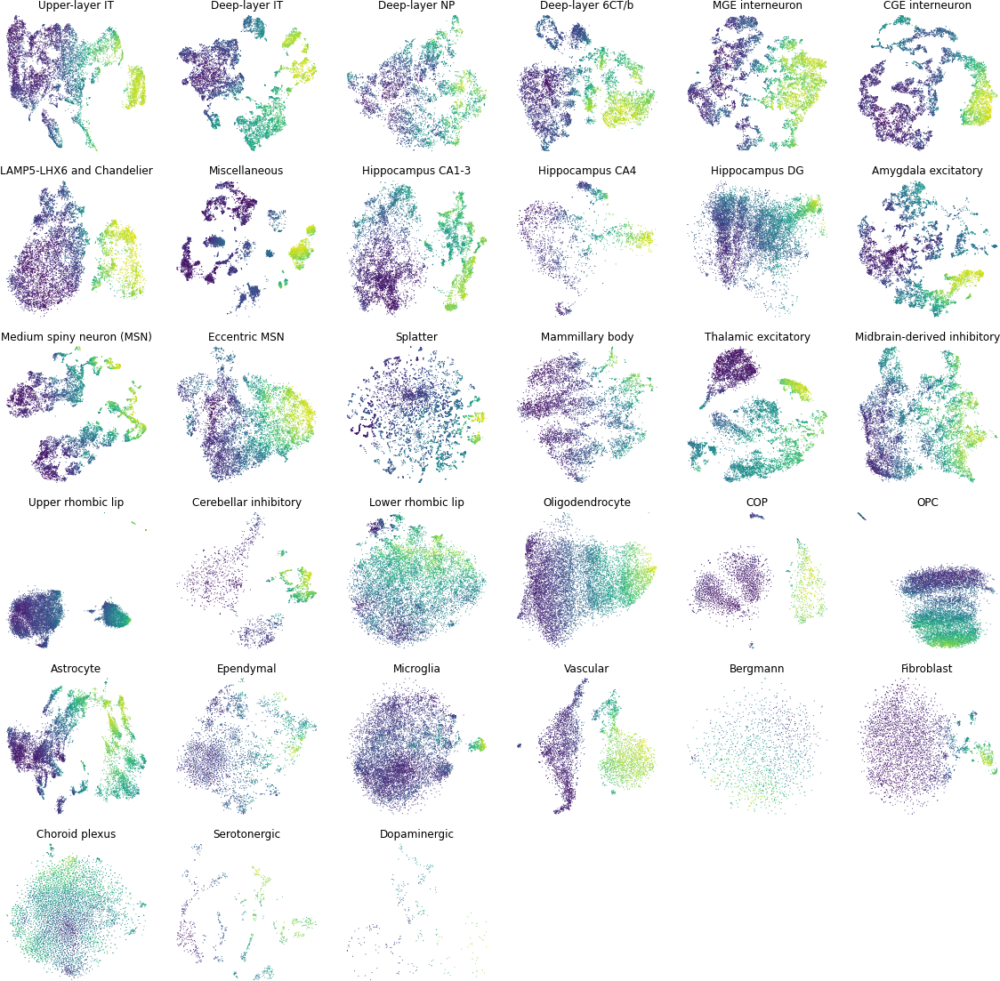

In [11]:
plt.figure(None, (20, 20))
gs = plt.GridSpec(6, 6)

donor = 'H18.30.002'

for i, cl in enumerate(superclusters):
    subset = A_names_rev[cl]
    if subset.endswith('EEEE') or subset.endswith('DDDD'):
        subset_file = f'/proj/human_adult/20220222/harmony/by_cluster/data/{subset}.loom'
    else:
        subset_file = f'/proj/human_adult/20220222/harmony/paris_top_bug/data/{subset}.loom'
    with loompy.connect(subset_file, 'r') as ds:        
        xy = ds.ca.TSNE
        plt.subplot(gs[i])
        plt.scatter(xy[selected[donor][subset], 0], xy[selected[donor][subset], 1], c=comps[donor][subset][:, 0], s=1, lw=0, rasterized=True)
        plt.axis('off')
        plt.title(cl)
        plt.margins(0.01, 0.01)
plt.show()

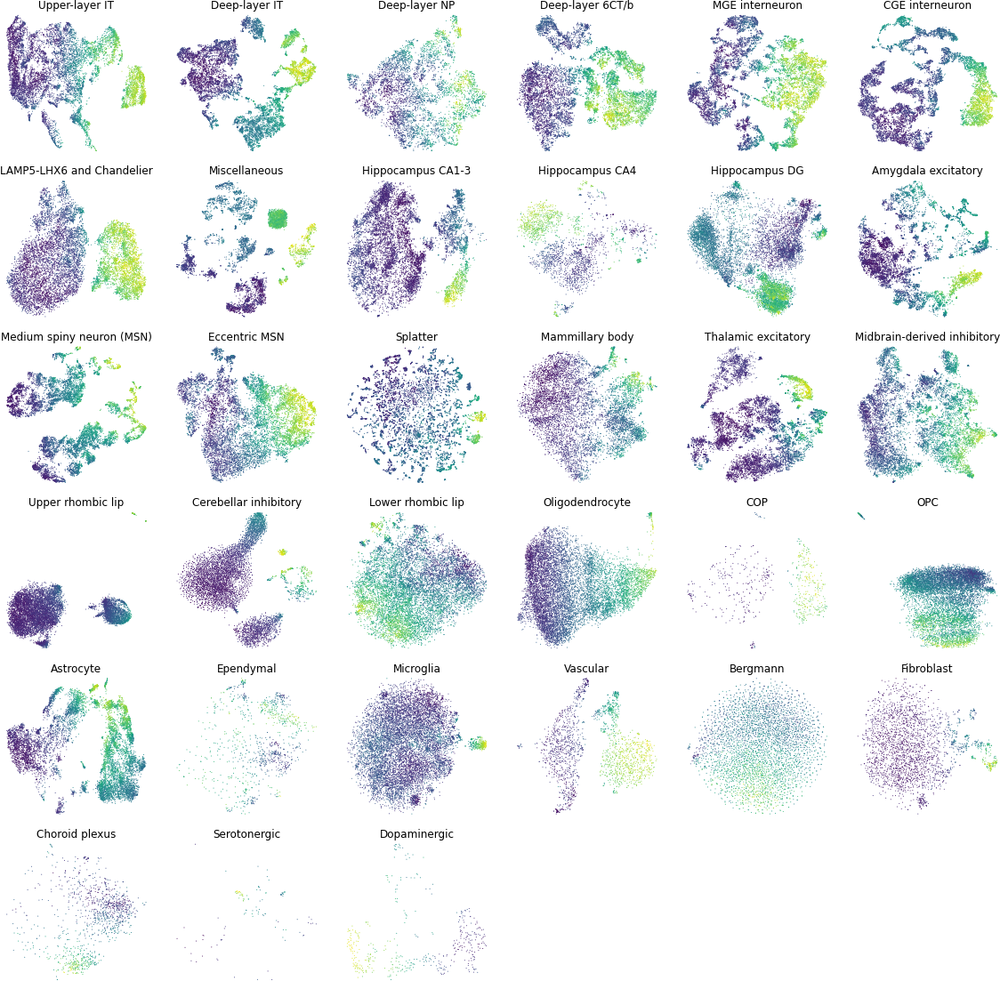

In [12]:
plt.figure(None, (20, 20))
gs = plt.GridSpec(6, 6)

donor = 'H19.30.001'

for i, cl in enumerate(superclusters):
    subset = A_names_rev[cl]
    if subset.endswith('EEEE') or subset.endswith('DDDD'):
        subset_file = f'/proj/human_adult/20220222/harmony/by_cluster/data/{subset}.loom'
    else:
        subset_file = f'/proj/human_adult/20220222/harmony/paris_top_bug/data/{subset}.loom'
    with loompy.connect(subset_file, 'r') as ds:        
        xy = ds.ca.TSNE
        plt.subplot(gs[i])
        plt.scatter(xy[selected[donor][subset], 0], xy[selected[donor][subset], 1], c=comps[donor][subset][:, 0], s=1, lw=0, rasterized=True)
        plt.axis('off')
        plt.title(cl)
        plt.margins(0.01, 0.01)
plt.show()

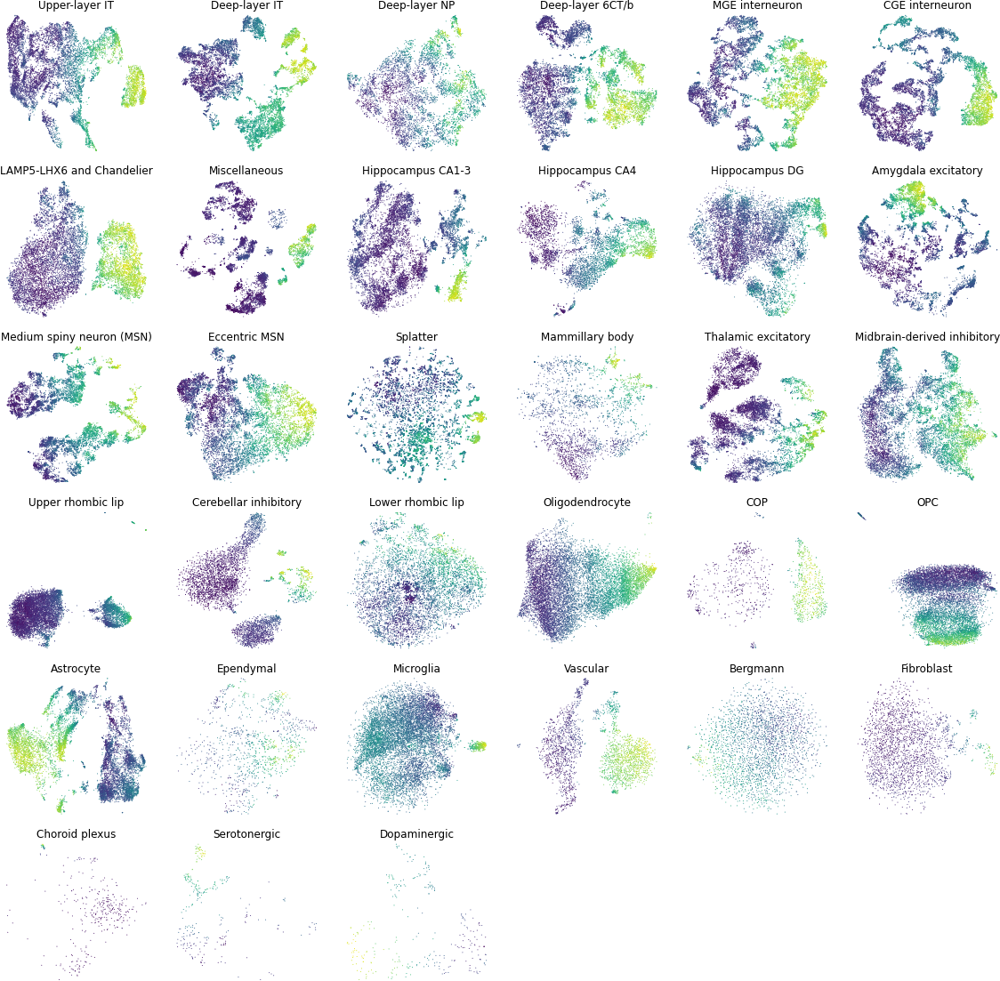

In [13]:
plt.figure(None, (20, 20))
gs = plt.GridSpec(6, 6)

donor = 'H19.30.002'

for i, cl in enumerate(superclusters):
    subset = A_names_rev[cl]
    if subset.endswith('EEEE') or subset.endswith('DDDD'):
        subset_file = f'/proj/human_adult/20220222/harmony/by_cluster/data/{subset}.loom'
    else:
        subset_file = f'/proj/human_adult/20220222/harmony/paris_top_bug/data/{subset}.loom'
    with loompy.connect(subset_file, 'r') as ds:        
        xy = ds.ca.TSNE
        plt.subplot(gs[i])
        plt.scatter(xy[selected[donor][subset], 0], xy[selected[donor][subset], 1], c=comps[donor][subset][:, 0], s=1, lw=0, rasterized=True)
        plt.axis('off')
        plt.title(cl)
        plt.margins(0.01, 0.01)
plt.show()

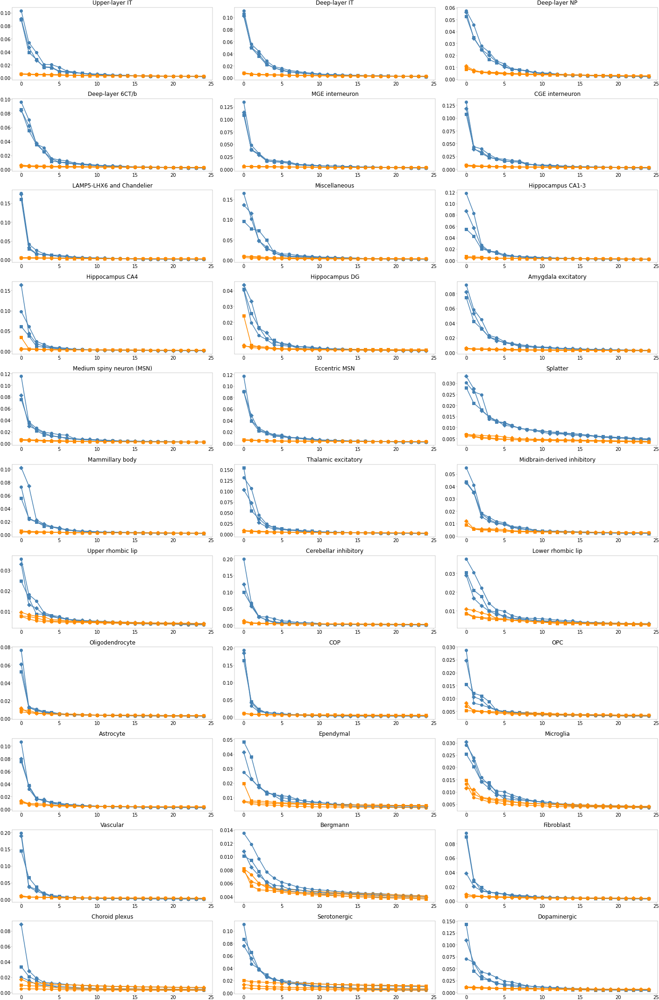

In [14]:
plt.figure(None, (20, 30))
gs = plt.GridSpec(11, 3)

donor_marker = {
    'H18.30.002': 'o',
    'H19.30.001': 's',
    'H19.30.002': 'D'
}

for i, cl in enumerate(superclusters):
    subset = A_names_rev[cl]
    for donor in ['H18.30.002', 'H19.30.001', 'H19.30.002']:
        plt.subplot(gs[i])
        plt.plot(np.arange(25), exp_var[donor][subset][:25], marker=donor_marker[donor], color='steelblue')
        plt.plot(np.arange(25), exp_var_permuted[donor][subset][:25], marker=donor_marker[donor], color='darkorange')
        plt.title(cl)

plt.tight_layout()

    

16
12
11


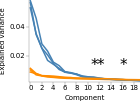

In [15]:
subset = 'harmony_A_R_Clean'

plt.figure(None, (2, 1.5))
ax = plt.subplot(111)

for donor in ['H18.30.002', 'H19.30.001', 'H19.30.002']:

    ix = np.where(exp_var[donor][subset] / exp_var_permuted[donor][subset] <= 1.10)[0][0]
    print(ix)
    plt.text(ix - 0.5, 0.01, '*', fontsize=15)
    plt.plot(exp_var[donor][subset][:20], color='steelblue')
    plt.plot(exp_var_permuted[donor][subset][:20], color='darkorange')

plt.margins(0.01, 0.01)
plt.xticks(np.arange(0, 20, 2), fontsize=7)
plt.yticks(fontsize=7)
plt.xlabel('Component', fontsize=7)
plt.ylabel('Explained variance', fontsize=7)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)

plt.savefig(f'{figure_folder}/pca_example.pdf', dpi=300)

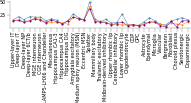

In [16]:
#plt.figure(None, (2.3, 0.3))
plt.figure(None, (3.25, 0.5))

donor_color = {
    'H18.30.002': 'steelblue',
    'H19.30.001': 'darkorange',
    'H19.30.002': 'purple'
}

ax = plt.subplot(111)

# where exp var <= 1.10

for donor in ['H18.30.002', 'H19.30.001', 'H19.30.002']:

    plt.plot(
        np.arange(len(superclusters)),
        [np.where(exp_var[donor][A_names_rev[cl]] / exp_var_permuted[donor][A_names_rev[cl]]<= 1.11)[0][0] for cl in superclusters],
        marker='o',
        linewidth=0.5,
        markersize=1,
        color=donor_color[donor]
    )

plt.margins(x=0.02)
plt.xticks(range(len(superclusters)), superclusters, fontsize=5, rotation=90)
plt.yticks(fontsize=5)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)

plt.savefig(f'{figure_folder}/pca_number_pcs.pdf', dpi=300)


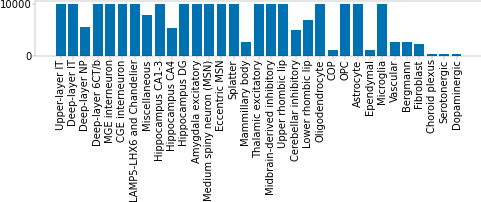

In [17]:
n_cells = np.array([selected[donor][A_names_rev[cl]].shape[0] for cl in superclusters])

plt.figure(None, (8, 1))
plt.bar(superclusters, n_cells)
plt.xticks(rotation=90)
plt.show()

In [18]:
for donor in ['H18.30.002', 'H19.30.001', 'H19.30.002']:
    n_cells = np.array([selected[donor][A_names_rev[cl]].shape[0] for cl in superclusters])
    print(donor)
    print(superclusters[n_cells < 10_000])

H18.30.002
['Deep-layer NP' 'Hippocampus CA4' 'Mammillary body'
 'Cerebellar inhibitory' 'COP' 'Ependymal' 'Vascular' 'Bergmann'
 'Fibroblast' 'Choroid plexus' 'Serotonergic' 'Dopaminergic']
H19.30.001
['Deep-layer NP' 'Miscellaneous' 'Hippocampus CA4' 'Mammillary body'
 'Cerebellar inhibitory' 'COP' 'Ependymal' 'Vascular' 'Bergmann'
 'Fibroblast' 'Choroid plexus' 'Serotonergic' 'Dopaminergic']
H19.30.002
['Deep-layer NP' 'Miscellaneous' 'Hippocampus CA4' 'Mammillary body'
 'Cerebellar inhibitory' 'Lower rhombic lip' 'COP' 'Ependymal' 'Vascular'
 'Bergmann' 'Fibroblast' 'Choroid plexus' 'Serotonergic' 'Dopaminergic']


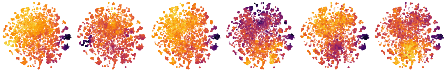

In [19]:
plt.figure(None, (8, 8/6))
gs = plt.GridSpec(1, 6)

subset = 'harmony_A_A'

i = 0
for donor in ['H18.30.002', 'H19.30.001', 'H19.30.002']:
    for c in [0, 1]:
        with loompy.connect(f'/proj/human_adult/20220222/harmony/paris_top_bug/data/{subset}.loom', 'r') as ds:
            xy = ds.ca.TSNE
            plt.subplot(gs[i])
            plt.scatter(
                xy[selected[donor][subset], 0], xy[selected[donor][subset], 1], c=comps[donor][subset][:, c], 
                s=1, 
                lw=0,
                cmap='inferno_r',
                rasterized=True
            )
            plt.axis('off')
            plt.margins(0.05, 0.05)
            i += 1

plt.subplots_adjust(wspace=0, hspace=0)
plt.savefig(f'{figure_folder}/pca_top_splatter.pdf', dpi=300)

# First principal component of each dissections

In [25]:
with loompy.connect('/proj/human_adult/20220222/harmony/paris_top_bug/data/Pool.loom', 'r') as ds:
    dis_attr = pd.Series(clean_roi(ds.ca.Roi)).str.replace('Human ', '')
    all_dissections = np.unique(dis_attr)
    roi_group_dict = dict(zip(dis_attr, ds.ca.ROIGroupCoarse))

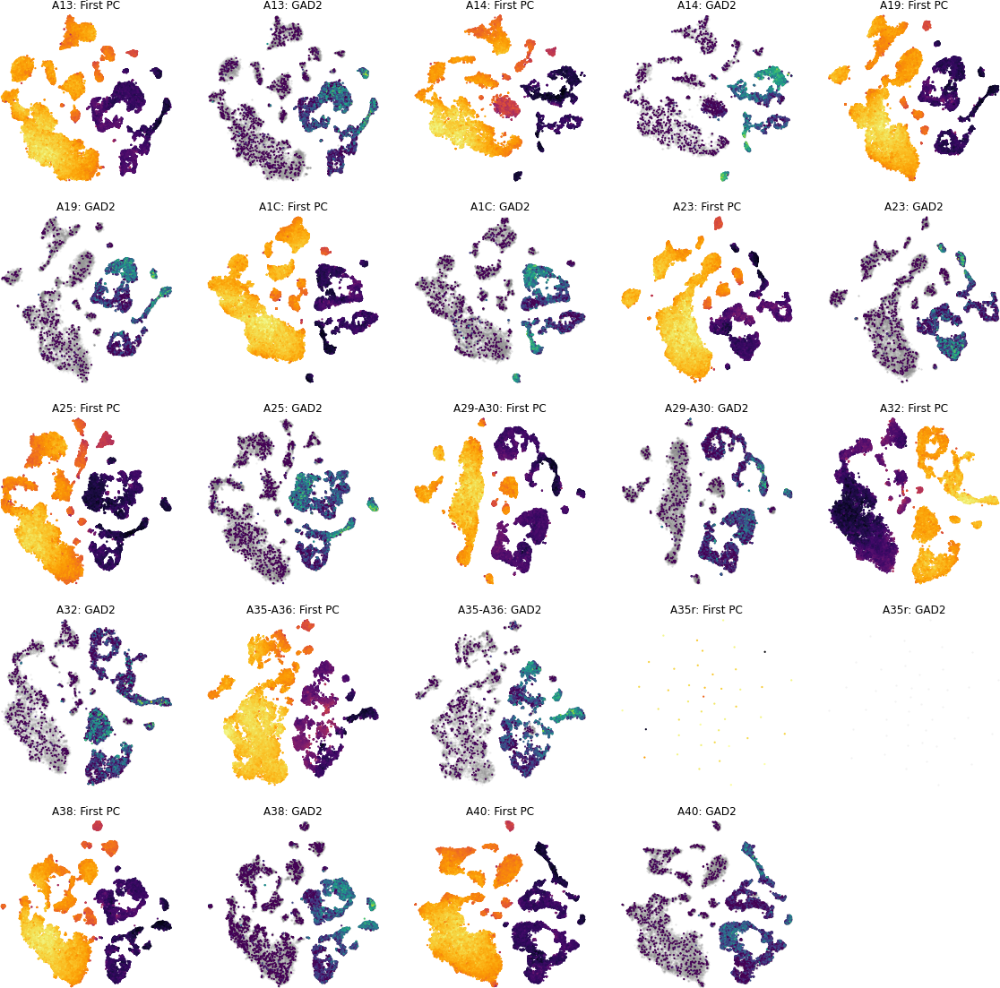

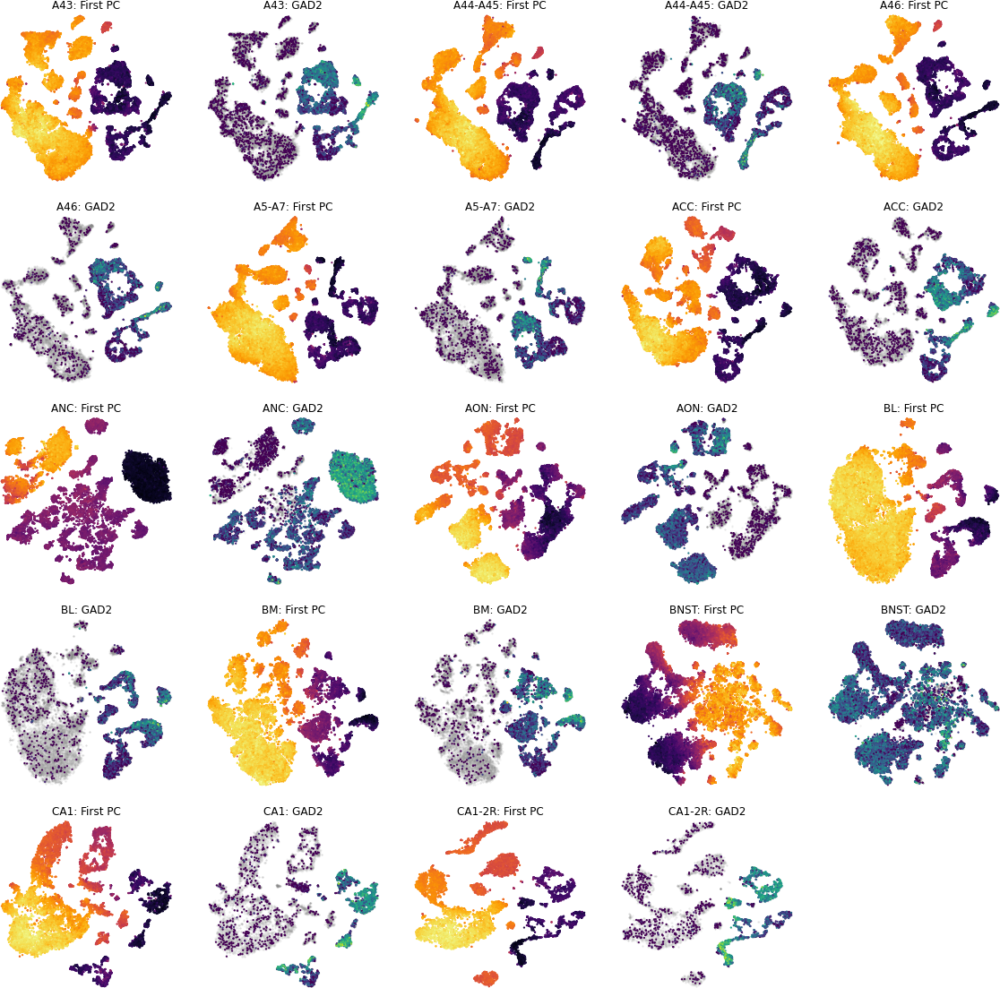

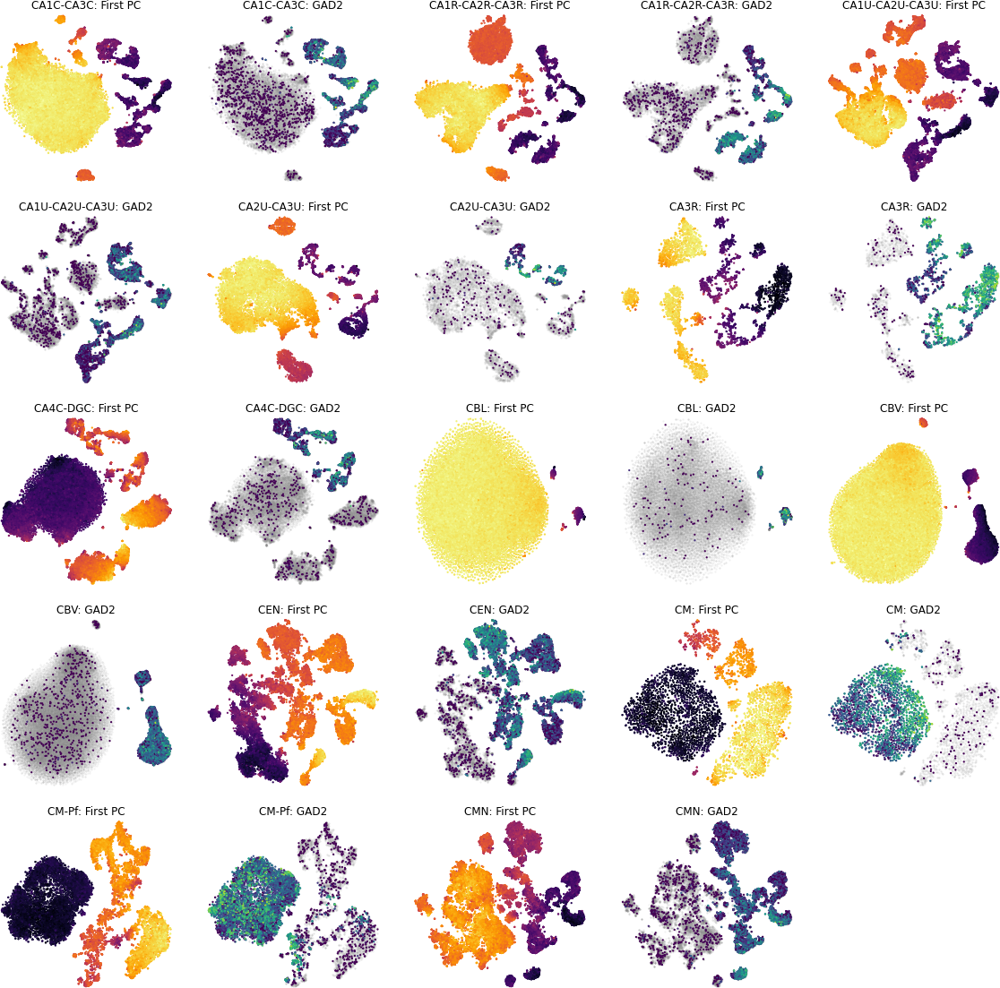

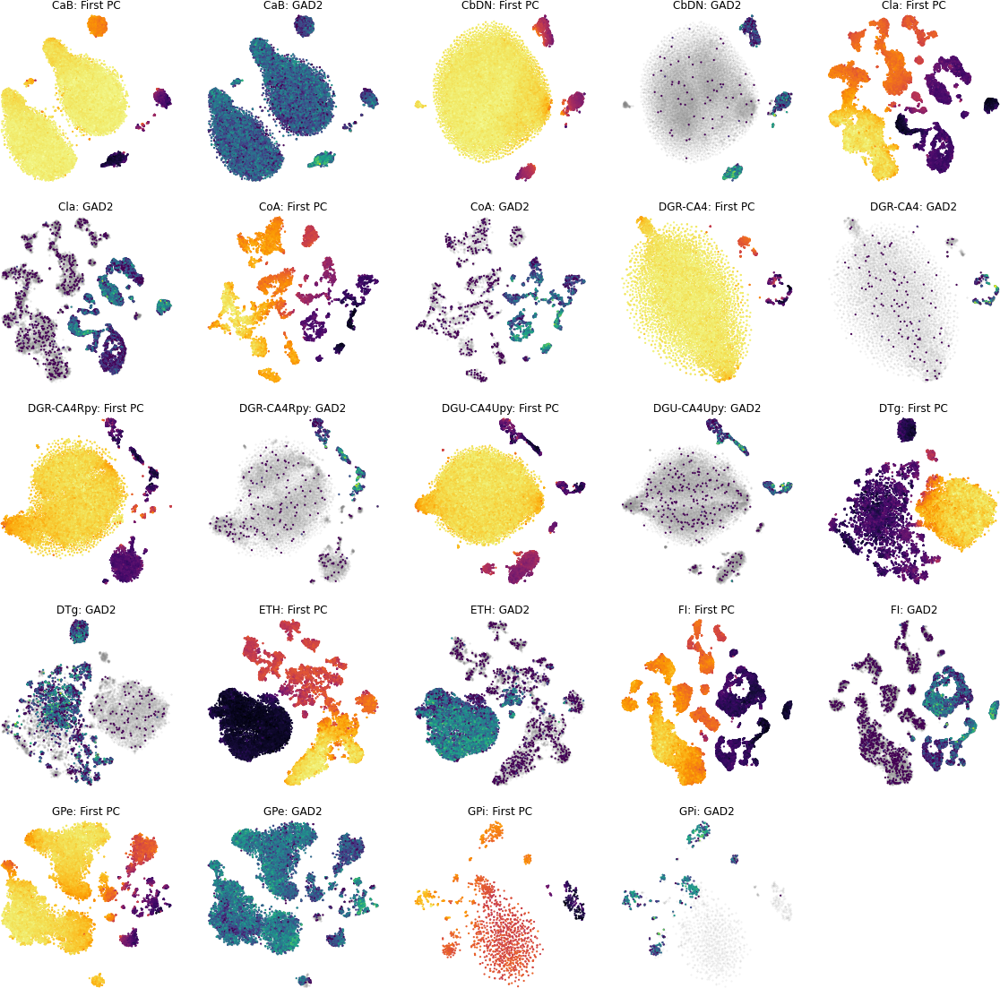

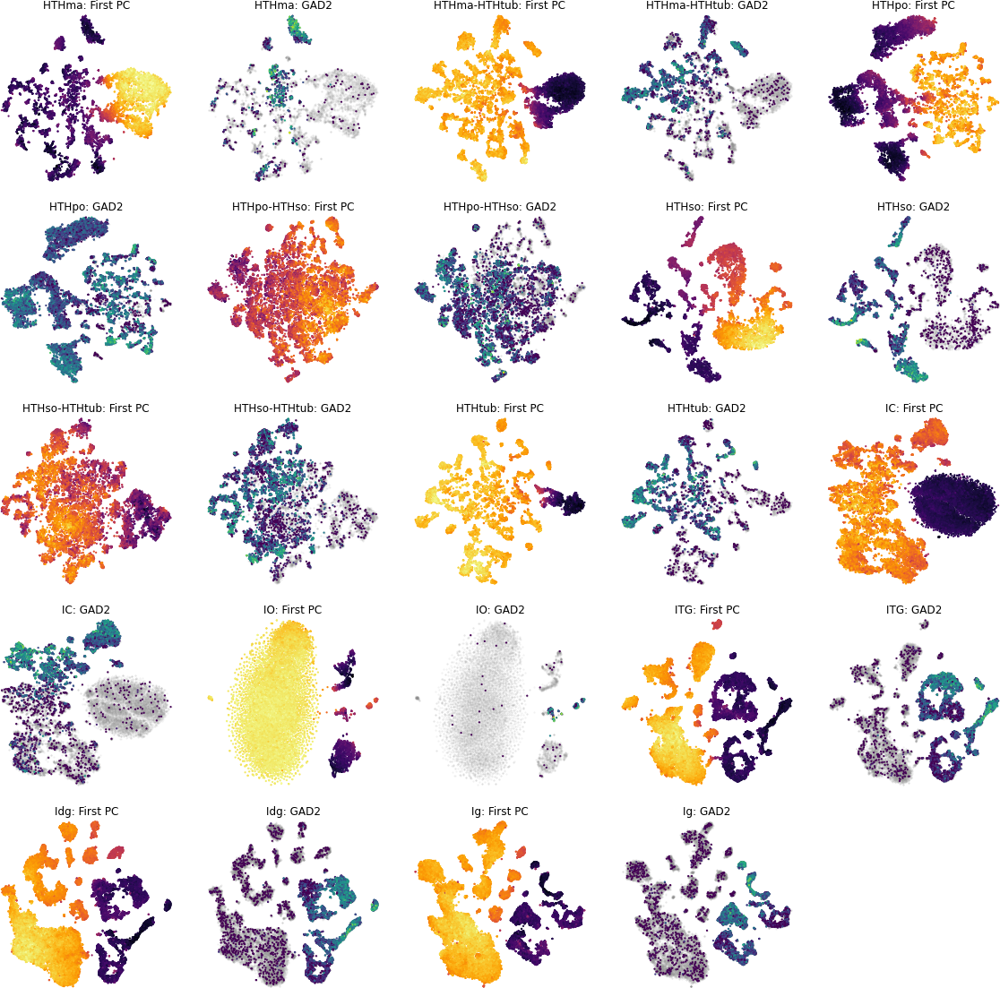

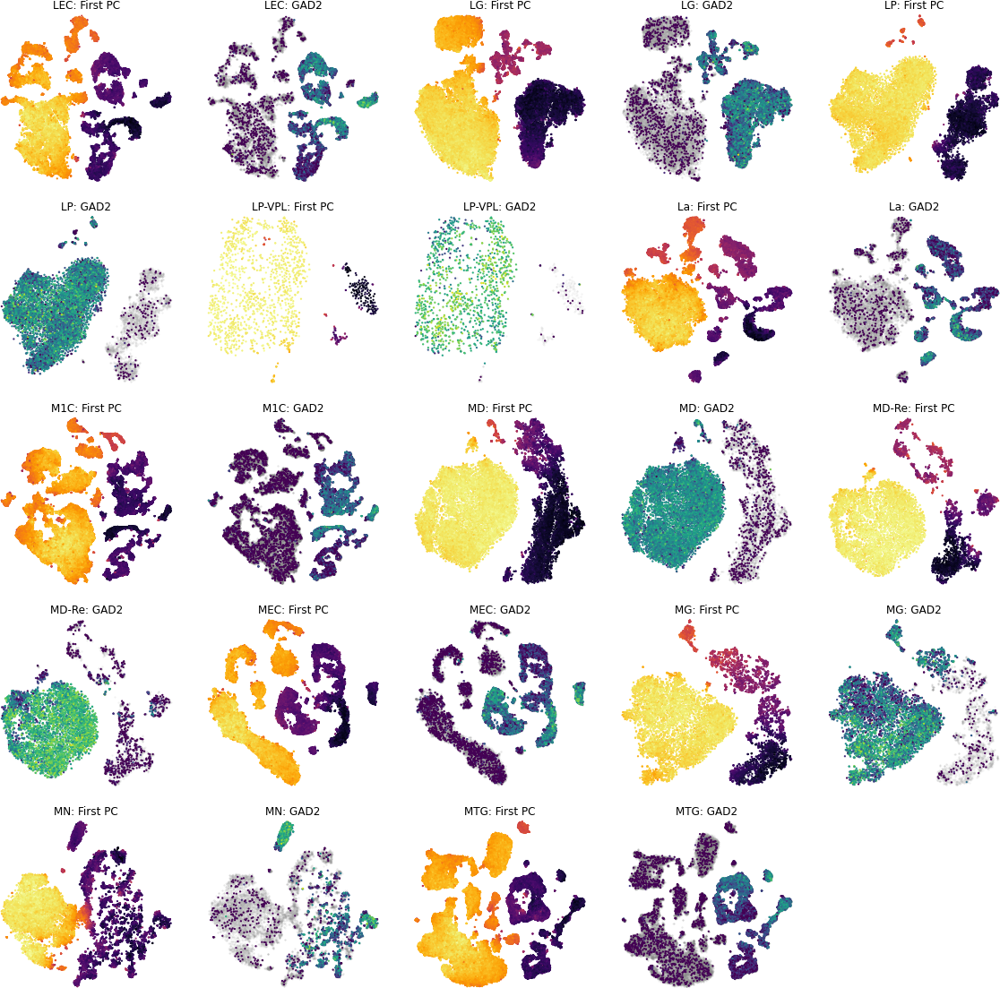

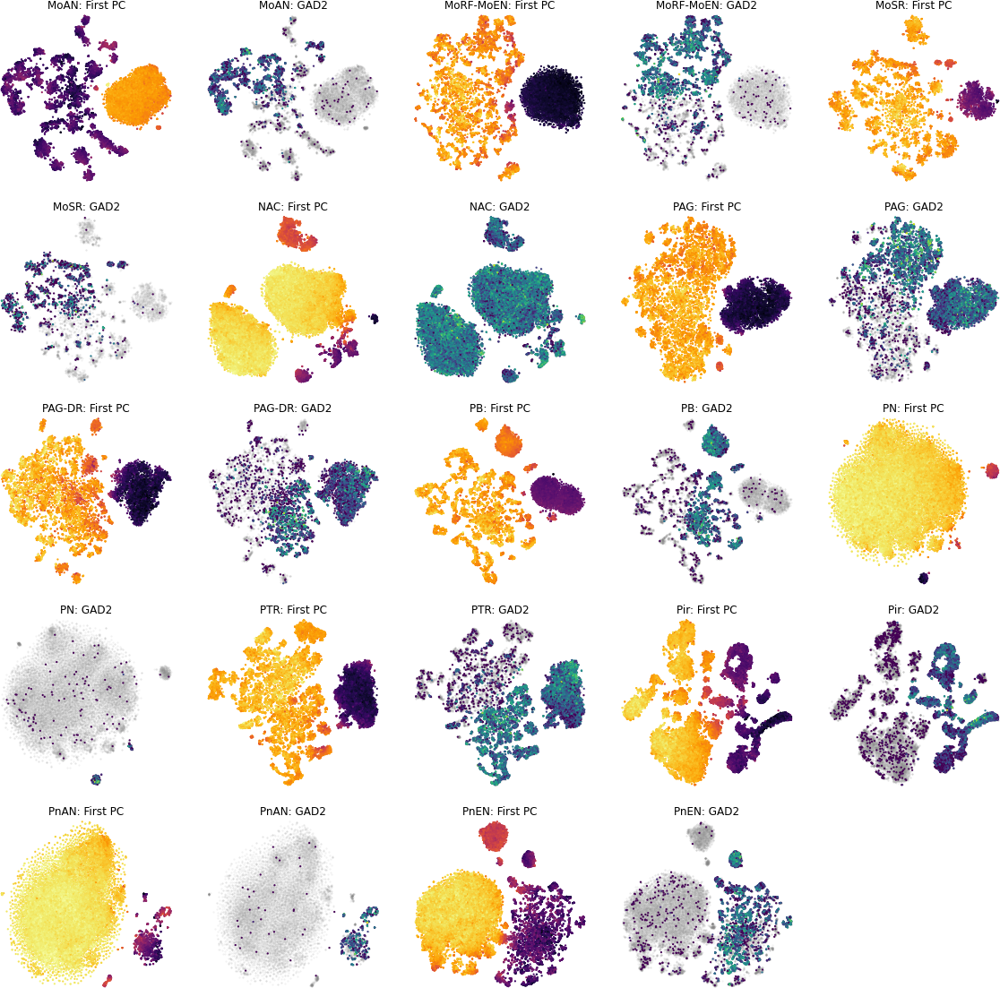

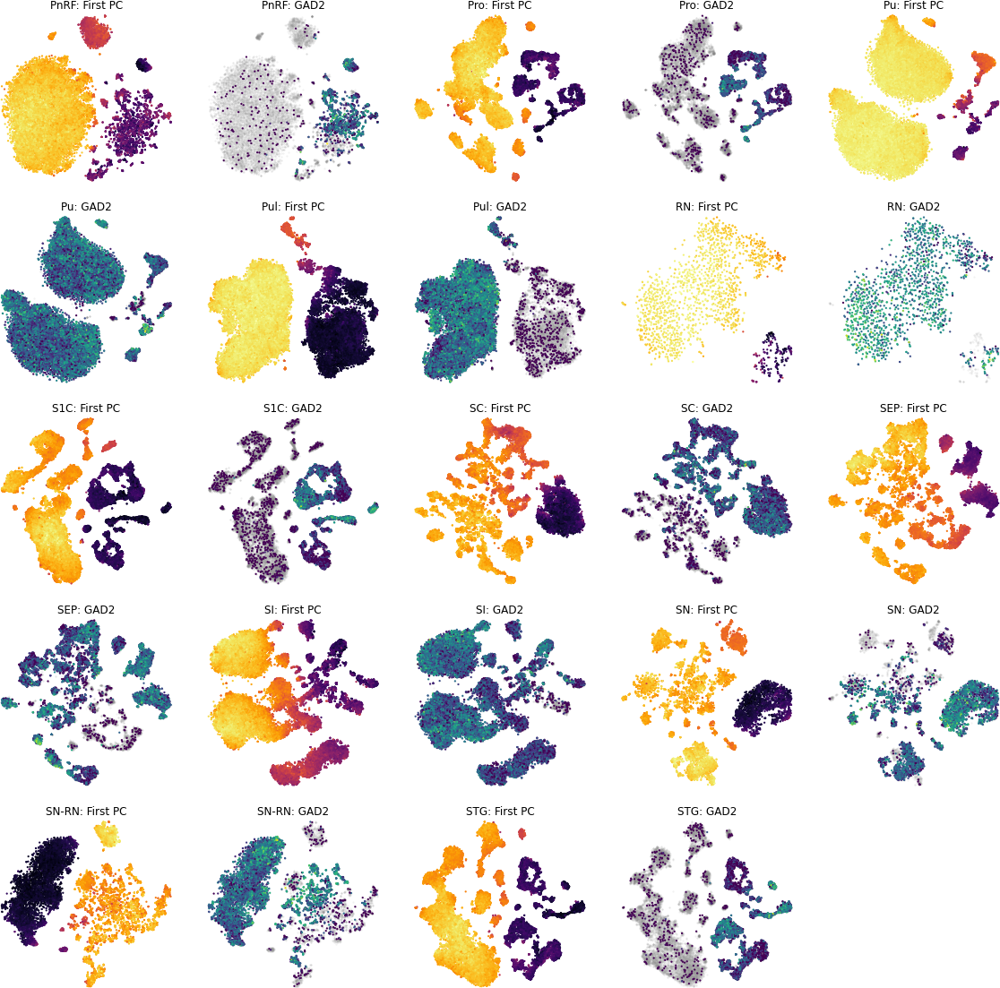

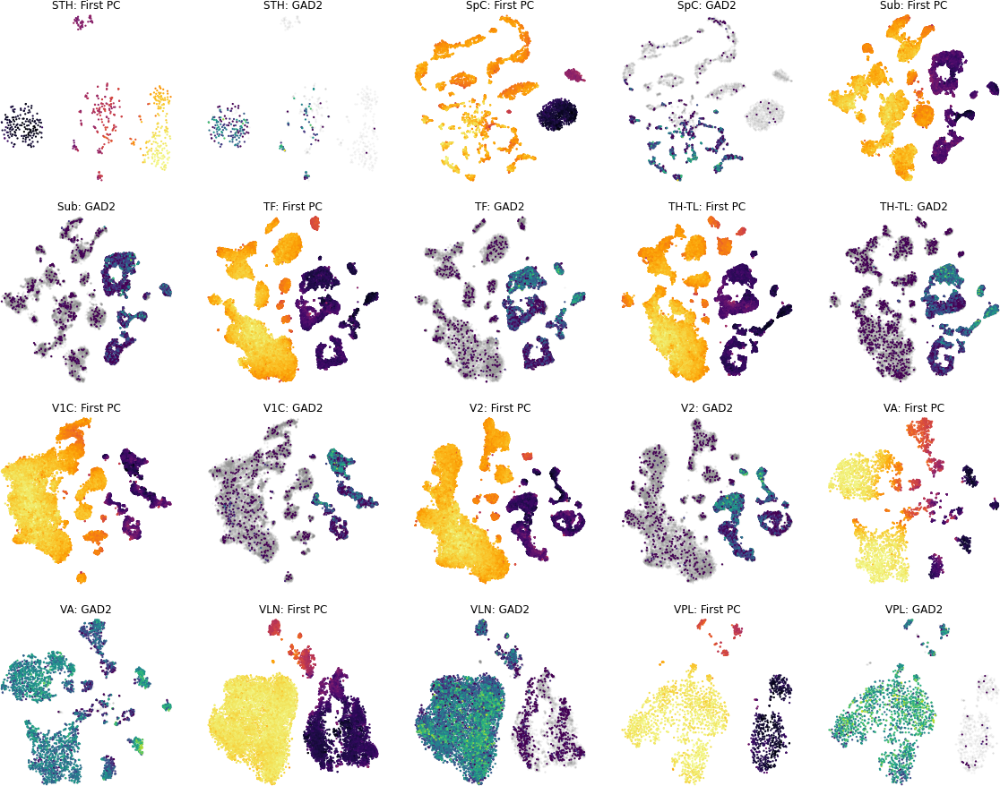

In [26]:
n = 0
n_step = 12

while n < len(all_dissections):
    
    plt.figure(None, (20, 20))
    gs = plt.GridSpec(5, 5)

    i = 0
    
    for dis in all_dissections[n:n + n_step]:

        with loompy.connect(f'/proj/human_adult/20220222/harmony/revision/data/Dis-{dis}.loom', 'r') as ds:

            plt.subplot(gs[i])
            plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=ds.ca.PCA[:, 0], s=5, lw=0, rasterized=True, cmap='inferno_r')
            plt.axis('off')
            plt.title(f'{dis}: First PC')
            plt.margins(0.01, 0.01)

            plt.subplot(gs[i + 1])
            exp = np.log(ds[np.where(ds.ra.Gene == 'GAD2')[0][0], :].flatten() + 1)
            cells = exp > 0
            plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], color='grey', alpha=0.1, s=5, lw=0, rasterized=True)
            plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=exp[cells], s=5, lw=0, rasterized=True)
            plt.axis('off')
            plt.title(f'{dis}: GAD2')
            plt.margins(0.01, 0.01)

        i += 2
    
    plt.show()
    
    n += n_step

<Figure size 1440x1440 with 0 Axes>

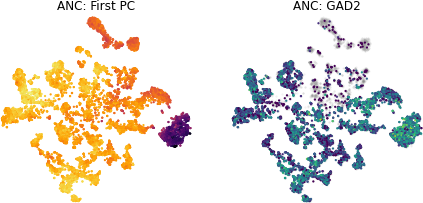

<Figure size 1440x1440 with 0 Axes>

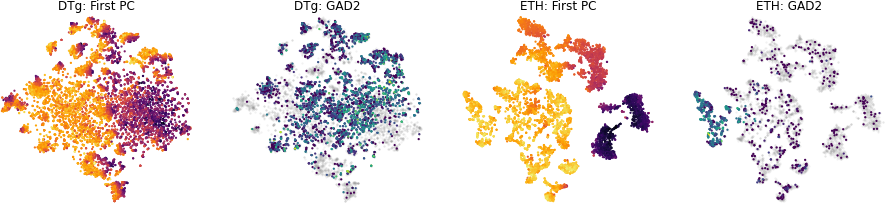

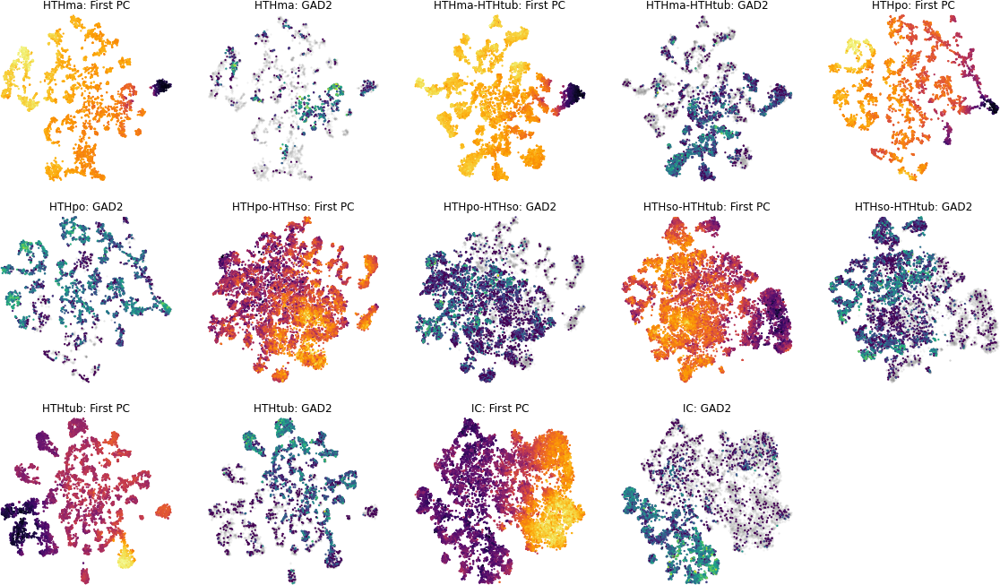

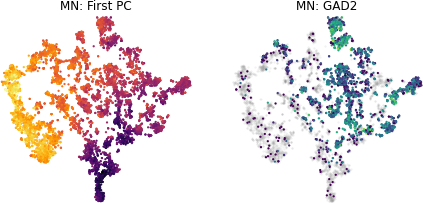

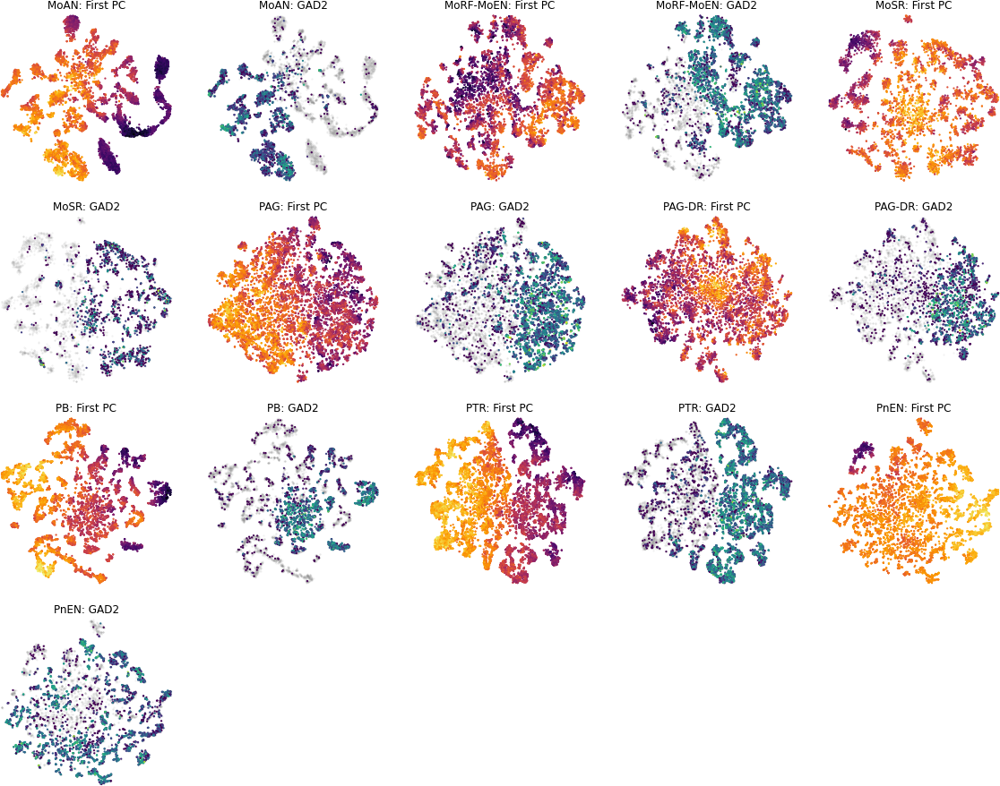

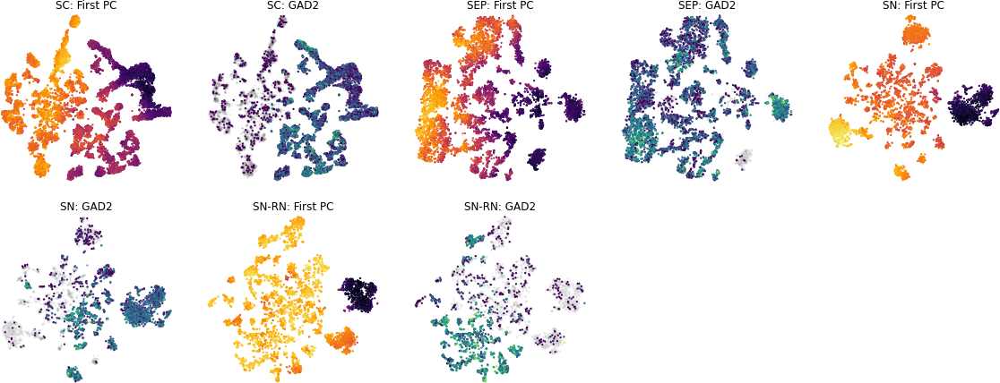

<Figure size 1440x1440 with 0 Axes>

In [27]:
n = 0
n_step = 12

while n < len(all_dissections):
    
    plt.figure(None, (20, 20))
    gs = plt.GridSpec(5, 5)

    i = 0
    
    for dis in all_dissections[n:n + n_step]:

        filename = f'/proj/human_adult/20220222/harmony/revision/data/Dis-Splatter{dis}.loom'
        if not os.path.exists(filename):
            continue
        
        with loompy.connect(filename, 'r') as ds:

            plt.subplot(gs[i])
            plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=ds.ca.PCA[:, 0], s=5, lw=0, rasterized=True, cmap='inferno_r')
            plt.axis('off')
            plt.title(f'{dis}: First PC')
            plt.margins(0.01, 0.01)

            plt.subplot(gs[i + 1])
            exp = np.log(ds[np.where(ds.ra.Gene == 'GAD2')[0][0], :].flatten() + 1)
            cells = exp > 0
            plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], color='grey', alpha=0.1, s=5, lw=0, rasterized=True)
            plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=exp[cells], s=5, lw=0, rasterized=True)
            plt.axis('off')
            plt.title(f'{dis}: GAD2')
            plt.margins(0.01, 0.01)

        i += 2
    
    plt.show()
    
    n += n_step

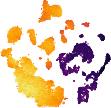

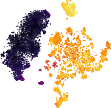

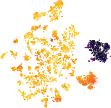

In [28]:
for dis in ['-A13', '-SN-RN', '-SplatterSN-RN']:

    with loompy.connect(f'/proj/human_adult/20220222/harmony/revision/data/Dis{dis}.loom', 'r') as ds:
        plt.figure(None, (2, 2))
        plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=ds.ca.PCA[:, 0], s=1, lw=0, rasterized=True, cmap='inferno_r')
        plt.margins(0.01, 0.01)
        plt.axis('off')
        plt.savefig(f'{figure_folder}/first_components{dis}.pdf', dpi=300)

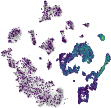

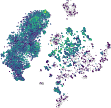

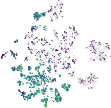

In [29]:
for dis in ['-A13', '-SN-RN', '-SplatterSN-RN']:
    
    with loompy.connect(f'/proj/human_adult/20220222/harmony/revision/data/Dis{dis}.loom', 'r') as ds:

        plt.figure(None, (2, 2))
        exp = np.log(ds[np.where(ds.ra.Gene == 'GAD2')[0][0], :].flatten() + 1)
        cells = exp > 0
        plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], color='grey', alpha=0.1, s=1, lw=0, rasterized=True)
        plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=exp[cells], s=1, lw=0, rasterized=True)
        plt.axis('off')
        plt.margins(0.01, 0.01)
        plt.savefig(f'{figure_folder}/GAD2{dis}.pdf', dpi=300)

In [61]:
cc_by_region = {
    'Cerebral cortex': [],
    'Hippocampus': [],
    'Cerebral nuclei': [],
    'Hypothalamus': [],
    'Thalamus': [],
    'Midbrain': [],
    'Pons': [],
    'Cerebellum': [],
    'Myelencephalon': [],
    'Spinal cord': []
}

for dis in all_dissections:
    
    with loompy.connect(f'/proj/human_adult/20220222/harmony/revision/data/Dis-{dis}.loom', 'r') as ds:
        
        # get log2 GAD2 expression
        exp = np.log2(ds[ds.ra.Gene == 'GAD2', :].flatten() + 1)
        # correlation to first PC
        cc = np.corrcoef(exp, ds.ca.PCA[:, 0])[0, 1]
        # skip if nan, should just be A35r with no neurons
        if np.isnan(cc):
            print('skipped', dis)
            continue
        # add absolute value to empty dict
        cc_by_region[roi_group_dict[dis]] += [np.abs(cc)]
        
        if roi_group_dict[dis] == 'Pons':
            print(dis, np.abs(cc))

skipped A35r
DTg 0.473733936262982
PB 0.24593221459700051
PN 0.7026190852381698
PnAN 0.5620062759555061
PnEN 0.58241092149525
PnRF 0.6082899714710501


In [62]:
splatter_cc_by_region = {
    'Cerebral cortex': [],
    'Hippocampus': [],
    'Cerebral nuclei': [],
    'Hypothalamus': [],
    'Thalamus': [],
    'Midbrain': [],
    'Pons': [],
    'Cerebellum': [],
    'Myelencephalon': [],
    'Spinal cord': []
}

for dis in all_dissections:
        
    filename = f'/proj/human_adult/20220222/harmony/revision/data/Dis-Splatter{dis}.loom'
    if not os.path.exists(filename):
        # skip if no splatter neuron subset exists
        continue
    
    with loompy.connect(filename, 'r') as ds:
        
        # get log2 GAD2 expression
        exp = np.log2(ds[ds.ra.Gene == 'GAD2', :].flatten() + 1)
        # correlation to first PC
        cc = np.corrcoef(exp, ds.ca.PCA[:, 0])[0, 1]
        # skip if nan, should just be A35r with no neurons
        if np.isnan(cc):
            print('skipped', dis)
            continue
        # add absolute value to splatter dict
        splatter_cc_by_region[roi_group_dict[dis]] += [np.abs(cc)]


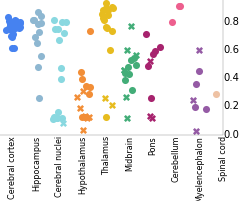

In [63]:
plt.figure(None, (4, 2.5))
ax = plt.subplot(111)

i = 0
width = 0.3
s = 50

# plot dissection correlations
for reg in cc_by_region:
    
    data = cc_by_region[reg]
        
    x = np.array([i] * len(data))
    plt.scatter(
        np.random.uniform(x - width, i + width), 
        data,
        s=s,
        lw=0,
        color=color_dict[reg],
        rasterized=True
    )
            
    plt.margins(0.02, 0.03)
    
    ax.spines.top.set_visible(False)
    ax.yaxis.set_label_position("right")
    
    i += 1
    
i = 0
    
# plot correlations from splatter subset
for reg in splatter_cc_by_region:
    
    data = splatter_cc_by_region[reg]
        
    x = np.array([i] * len(data))
    plt.scatter(
        np.random.uniform(x - width, i + width), 
        data,
        s=s,
        lw=0,
        marker='X',
        color=color_dict[reg],
        rasterized=True
    )
            
    plt.margins(0.03, 0.03)
    
    ax.spines.top.set_visible(False)
    ax.spines.left.set_visible(False)
    ax.tick_params(length=0)
    ax.yaxis.tick_right()
    
    i += 1

plt.xticks(range(10), list(cc_by_region.keys()), rotation=90, fontsize=8)
plt.savefig(f'{figure_folder}/first_components_correlation.pdf', dpi=300)
plt.show()

# Analyze splatter neurons without Harmony batch correction for donor

<Figure size 1440x1440 with 0 Axes>

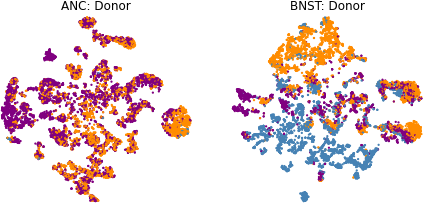

<Figure size 1440x1440 with 0 Axes>

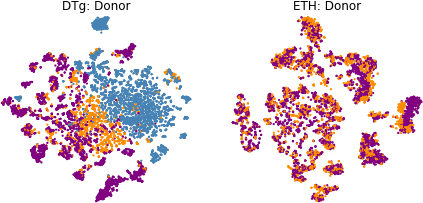

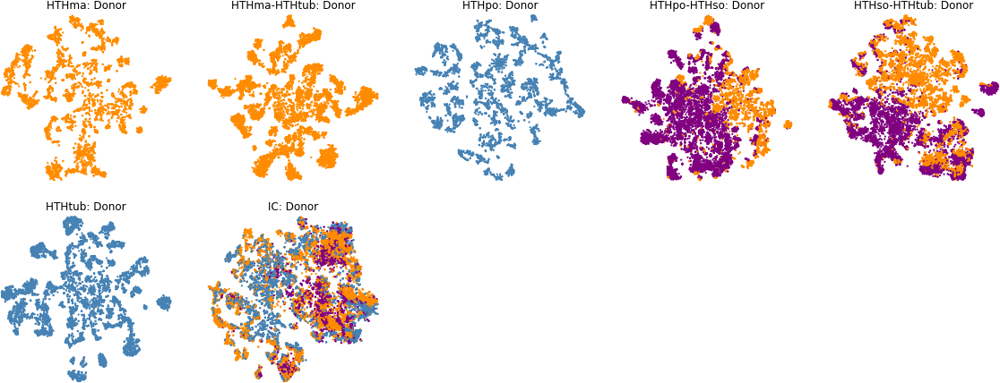

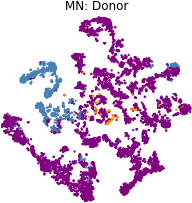

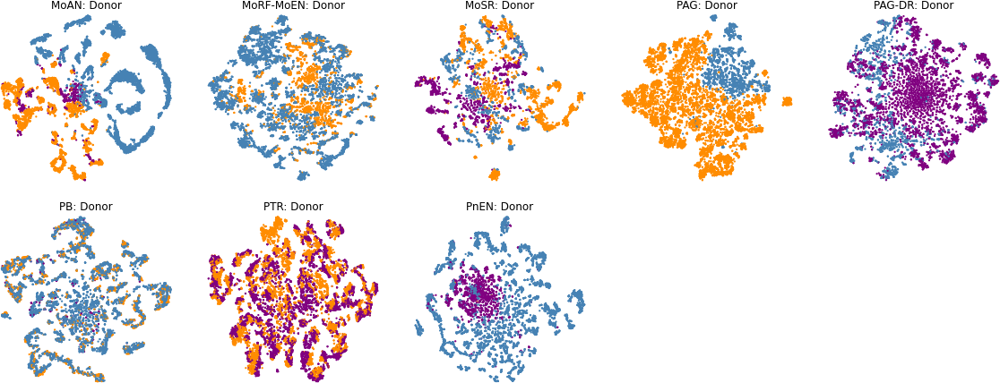

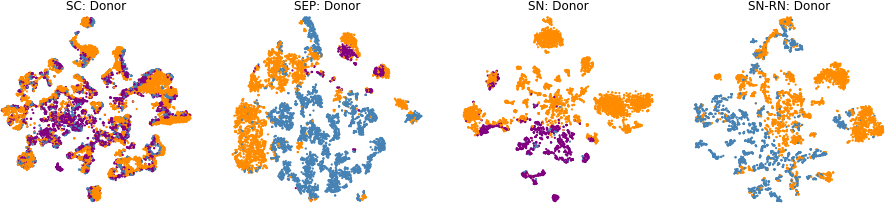

<Figure size 1440x1440 with 0 Axes>

In [74]:
n = 0
n_step = 12

donor_color = {
    'H18.30.002': 'steelblue',
    'H19.30.001': 'darkorange',
    'H19.30.002': 'purple'
}

while n < len(all_dissections):
    
    plt.figure(None, (20, 20))
    gs = plt.GridSpec(5, 5)

    i = 0
    
    for dis in all_dissections[n:n + n_step]:

        filename = f'/proj/human_adult/20220222/harmony/revision/data/Dis-Splatter{dis}-NoBatch.loom'
        if not os.path.exists(filename):
            continue
        
        with loompy.connect(filename, 'r') as ds:

            c = np.array([donor_color[x] for x in ds.ca.Donor])
            
            plt.subplot(gs[i])
            plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=c, s=5, lw=0, rasterized=True)
            plt.axis('off')
            plt.title(f'{dis}: Donor')
            plt.margins(0.01, 0.01)

        i += 1
    
    plt.show()
    
    n += n_step

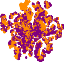

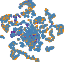

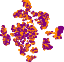

In [75]:
donor_color = {
    'H18.30.002': 'steelblue',
    'H19.30.001': 'darkorange',
    'H19.30.002': 'purple'
}

for dis in ['PTR', 'PB', 'ETH']:
    
    with loompy.connect(f'/proj/human_adult/20220222/harmony/revision/data/Dis-Splatter{dis}-NoBatch.loom', 'r') as ds:

        c = np.array([donor_color[x] for x in ds.ca.Donor])
        
        plt.figure(None, (1.15, 1.15))
        plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=c, s=2, lw=0, rasterized=True)
        plt.axis('off')
        plt.margins(0.01, 0.01)
        plt.savefig(f'{figure_folder}/NoBatch-{dis}.pdf', dpi=300)

# Supercluster names, files, colors

In [20]:
superclusters = np.array(
    [
        'Upper-layer IT', 'Deep-layer IT', 'Deep-layer NP', 'Deep-layer 6CT/b',
        'MGE interneuron', 'CGE interneuron', 'LAMP5-LHX6 and Chandelier', 'Miscellaneous',
        'Hippocampus CA1-3', 'Hippocampus CA4', 'Hippocampus DG', 'Amygdala excitatory', 
        'Medium spiny neuron (MSN)', 'Eccentric MSN', 'Splatter',
        'Mammillary body', 'Thalamic excitatory', 'Midbrain-derived inhibitory', 
        'Upper rhombic lip', 'Cerebellar inhibitory', 'Lower rhombic lip',  
    ]
)

In [21]:
A_names = {
    'harmony_A_A': 'Splatter',
    'harmony_A_B': 'Deep-layer IT',
    'harmony_A_C_Clean': 'Upper-layer IT', 
    'harmony_A_D': 'Amygdala excitatory',
    'harmony_A_E_Clean': 'Miscellaneous',
    'harmony_A_F_Clean': 'MGE interneuron', 
    'harmony_A_G_Clean': 'CGE interneuron', 
    'harmony_A_H_Clean': 'Thalamic excitatory',
    'harmony_A_I_Clean': 'Deep-layer 6CT/b', 
    'harmony_A_J_Clean': 'Medium spiny neuron (MSN)', 
    'harmony_A_K_Clean_Clean': 'Upper rhombic lip', 
    'harmony_A_L_Clean': 'Cerebellar inhibitory', 
    'harmony_A_M': 'Hippocampus CA1-3', 
    'harmony_A_N_Clean_Clean': 'LAMP5-LHX6 and Chandelier', 
    'harmony_A_O_Clean': 'Hippocampus DG', 
    'harmony_A_P_Clean': 'Hippocampus CA4', 
    'harmony_A_Q_Clean': 'Eccentric MSN', 
    'harmony_A_R_Clean': 'Deep-layer NP', 
    'harmony_A_S_Clean': 'Midbrain-derived inhibitory',
    'harmony_A_T': 'Mammillary body',
    'harmony_A_U': 'Lower rhombic lip'  
}

In [22]:
superclass_color_dict = dict(
    zip(
        [
            'Astrocyte', 'Bergmann glia', 'CGE interneuron', 'Cerebellar inhibitory', 'Choroid plexus', 'Eccentric MSN', 'Ependymal', 'Amygdala excitatory',
            'Splatter', 'Lower rhombic lip', 'Hippocampus CA1-3', 'Hippocampus CA4', 'Hippocampus DG', 'Microglia', 'Upper-layer IT',
            'Deep-layer IT', 'Deep-layer NP', 'Deep-layer 6CT/b', 'LAMP5-LHX6 and Chandelier', 'MGE interneuron', 'Medium spiny neuron (MSN)', 'Mammillary body', 
            'Midbrain-derived inhibitory', 'Miscellaneous',
            'Oligodendrocyte precursor', 'Oligodendrocyte', 'Committed oligodendrocyte precursor',
            'Upper rhombic lip', 'Thalamic excitatory', 'Fibroblast', 'Vascular'
        ],
        [
            '#ab3bc4', '#e7c31f', '#983f00', '#4c005c', '#005c31', '#2bcd48', '#ed5f8e', '#808080', '#93feb4', '#8e7c00', '#9ccb00', '#c10087', '#003380',
            '#fea305', '#fea7ba', '#426600', '#ee1010', '#5ef0f1', '#00988e', '#dffe66', '#740afe', '#980000', '#fefe80', '#fefe00', '#0098d4', '#9cba19', '#7caa09',
            '#80baed', '#cc9f80', '#c48351', '#e12e12'
        ]
    )
)

In [25]:
supercluster_dict = dict(zip(list(A_names.values()), list(A_names.keys())))

## Plot quality-control metrics

In [23]:
with loompy.connect('/proj/human_adult/20220222/harmony/paris_top_bug/data/Pool.loom', 'r') as ds:
    ribo_ix = pd.Series(ds.ra.Gene).str.contains("^RP[SL]", regex=True).to_numpy()
    print(ds.ra.Gene[ribo_ix])
ribo_ix.sum()

['RPSAP52' 'RPS3AP23' 'RPL23P8' ... 'RPL34P22' 'RPL31P49' 'RPS10P16']


1299

In [28]:
with loompy.connect('/proj/human_adult/20220222/harmony/paris_top_bug/data/Pool.loom', 'r') as ds:
    
    n_umi = []
    n_gene = []
    mt = []
    unspliced = []
    ribo = []
    
    for name in superclusters:
        
        print(name)
        
        subset = supercluster_dict[name]
        cells = ds.ca.Punchcard == subset
        
        n_umi += [ds.ca.TotalUMI[cells]]
        n_gene += [ds.ca.NGenes[cells]]
        mt += [ds.ca.MT_ratio[cells]]
        unspliced += [ds.ca.unspliced_ratio[cells]]
        ribo += [ds.ca.RiboCount[cells] / ds.ca.TotalUMI[cells]]

Upper-layer IT
Deep-layer IT
Deep-layer NP
Deep-layer 6CT/b
MGE interneuron
CGE interneuron
LAMP5-LHX6 and Chandelier
Miscellaneous
Hippocampus CA1-3
Hippocampus CA4
Hippocampus DG
Amygdala excitatory
Medium spiny neuron (MSN)
Eccentric MSN
Splatter
Mammillary body
Thalamic excitatory
Midbrain-derived inhibitory
Upper rhombic lip
Cerebellar inhibitory
Lower rhombic lip


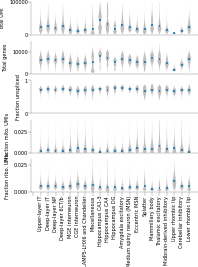

In [39]:
metric = [n_umi, n_gene, unspliced, mt, ribo]
y_max = [100_000, 15_000, 1, 0.04, 0.03]
y_label = ['Total UMI', 'Total genes', 'Fraction unspliced', 'Fraction mito. UMIs', 'Fraction ribo. UMIs']

plt.figure(None, (3, 3.5))
gs = plt.GridSpec(5, 1)

for i in range(len(metric)):
  
    ax = plt.subplot(gs[i])

    violin_parts = plt.violinplot(metric[i], showextrema=False, showmedians=True)
    for pc in violin_parts['bodies']:
        pc.set_facecolor('grey')
        pc.set_alpha(0.5)

    ax.spines.right.set_visible(False)
    ax.spines.top.set_visible(False)

    plt.xticks([])
    plt.yticks(fontsize=5)
    plt.ylabel(y_label[i], fontsize=5)
    plt.ylim(0, y_max[i])

plt.xticks(range(len(superclusters) + 1), [''] + list(superclusters), fontsize=5, rotation=90)
plt.savefig(f'{figure_folder}/qc_viol_all.pdf', dpi=300)

# Downsample the dataset by cluster

In [42]:
with loompy.connect(folder + 'Pool.loom', 'r') as ds:
    cell_dict = dict(zip(ds.ca.CellID, ds.ca.Punchcard))

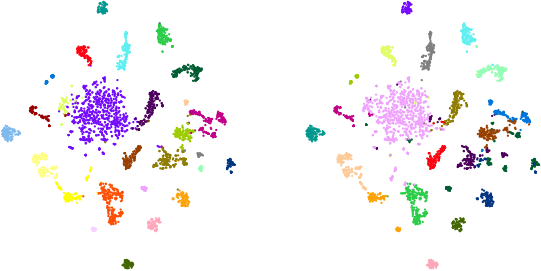

In [68]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    labels = ds.ca.Clusters
    
    plt.figure(None, (10, 5))
    ax = plt.subplot(121)
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=5, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=5, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')

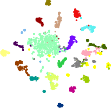

In [69]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells], s=2, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled10_superclusters.pdf', dpi=300)

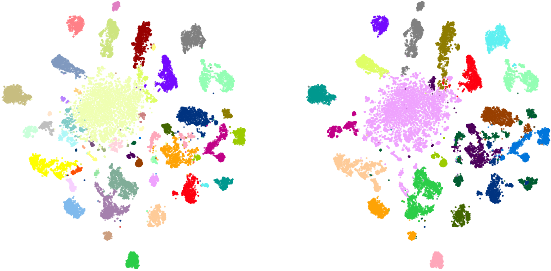

In [70]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100.loom', 'r') as ds:
    
    labels = ds.ca.Clusters
    
    plt.figure(None, (10, 5))
    ax = plt.subplot(121)
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=2, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=2, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')

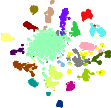

In [71]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells], s=1, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled100_superclusters.pdf', dpi=300)

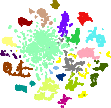

In [72]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled1000.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells], s=0.5, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled1000_superclusters.pdf', dpi=300)

## Analyze downsampled dataset without Harmony correction for donor

In [43]:
with loompy.connect(folder + 'Pool.loom', 'r') as ds:
    cell_dict = dict(zip(ds.ca.CellID, ds.ca.Punchcard))

In [51]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100NoHarmony.loom', 'r') as ds:
    print(ds.attrs.config)

paths:
  build: /proj/human_adult/20220222/harmony/revision
  samples: /proj/starloom/
  autoannotation: /home/kimberly/Github/auto-annotation/Human_adult
  metadata: /nfs/sanger-data/10X/DB/sqlite3_chromium.db
  fastqs: /proj/human_adult/test/index-hopping-filter/HJKKMDSXXandHJHGHDSXX/outs/fastq_path/{sampleid}_S*_L*_R?_001.fastq.gz
  index: /proj/human_adult/test/index-hopping-filter/human_GRCh38_gencode.v31.600
  qc: 
params:
  batch_keys: []
  k: 25
  k_pooling: 10
  factorization: PCA
  n_factors: 50
  min_umis: 0
  n_genes: 2000
  remove_doublets: False
  remove_low_quality: False
  mask: ('cellcycle', 'sex', 'ieg', 'mt')
  min_fraction_good_cells: 0.4
  max_fraction_MT_genes: 1
  min_fraction_unspliced_reads: 0.1
  max_doubletFinder_TH: 0.4
  skip_missing_samples: False
  skip_metadata: False
  features: variance
  clusterer: sknetwork
  nn_space: auto
  graph: RNN
  doublets_action: None
steps: ['nn', 'embeddings', 'clustering', 'aggregate', 'export']
execution:
  n_cpus: 28
  

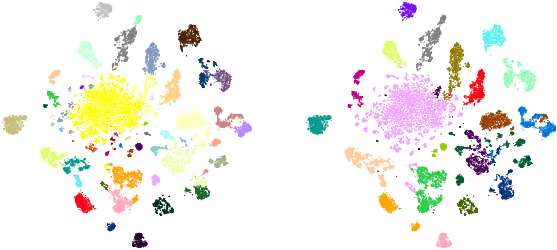

In [44]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100NoHarmony.loom', 'r') as ds:
    
    labels = ds.ca.Clusters
    
    plt.figure(None, (10, 5))
    ax = plt.subplot(121)
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=1, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=1, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')

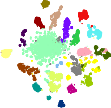

In [45]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100NoHarmony.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells], s=1, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled100NoHarmony_superclusters.pdf', dpi=300)

# Analyze downsampled dataset with only the variable genes from harmony_A_A (splatter) analysis

In [58]:
# check that these genes are the most variable genes in the splatter data

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100SplatterVar.loom', 'r') as ds:
    selected_genes = ds.ra.Gene
with loompy.connect('/proj/human_adult/20220222/harmony/paris_top_bug/data/harmony_A_A.loom', 'r') as ds: 
    print(np.union1d(selected_genes, ds.ra.Gene[ds.ra.Selected == 1]).shape)

(2000,)


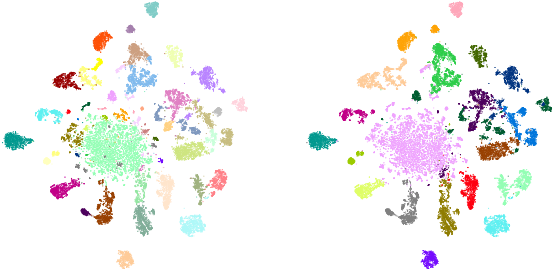

In [47]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100SplatterVar.loom', 'r') as ds:
    
    labels = ds.ca.Clusters
    
    plt.figure(None, (10, 5))
    ax = plt.subplot(121)
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=1, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=1, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')

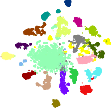

In [48]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100SplatterVar.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells], s=1, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled100SplatterVar.pdf', dpi=300)

# Analyze downsampled dataset with randomly selected genes

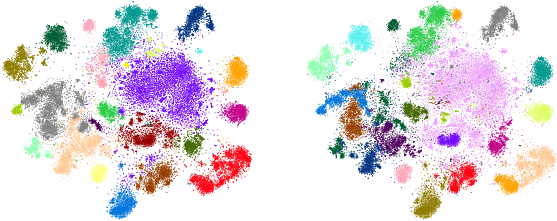

In [49]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100Random.loom', 'r') as ds:
  
    labels = ds.ca.Clusters
    
    plt.figure(None, (10, 5))
    ax = plt.subplot(121)
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=1, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(labels[cells]), s=1, lw=0, rasterized=True)
    
    ax.set_aspect('equal')
    plt.margins(0.01, 0.01)
    plt.axis('off')

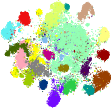

In [50]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100Random.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells], s=1, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled100Random.pdf', dpi=300)

## GMM clustering

In [59]:
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture

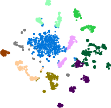

In [62]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    # Use GMM clustering
    gm = GaussianMixture(n_components=10, n_init=50).fit(ds.ca.PCA)
    clusters = gm.predict(ds.ca.PCA)

    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=colorize(clusters)[cells], s=2, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/GMM_Downsampled10.pdf', dpi=300)

In [63]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    frac_of_all_splatter = []
    frac_splatter_of_cluster = []
    for n in range(10):
        gm = GaussianMixture(n_components=10, n_init=50).fit(ds.ca.PCA)
        gmm_clusters = gm.predict(ds.ca.PCA)
        splatter_cluster, count = mode(gmm_clusters[labels == 'harmony_A_A'])
        frac = count[0] / (labels == 'harmony_A_A').sum()
        frac_of_all_splatter.append(frac)
        frac = count[0] / (gmm_clusters == splatter_cluster[0]).sum()
        frac_splatter_of_cluster.append(frac)

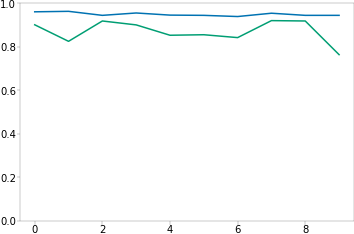

In [64]:
plt.plot(frac_of_all_splatter)
plt.plot(frac_splatter_of_cluster)
plt.ylim(0, 1)
plt.show()

# Downsampling specific superclusters

In [65]:
from sklearn.decomposition import PCA
from cytograph.embedding import art_of_tsne

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    data_norm = np.log2(ds[:, :] / ds.ca.TotalUMI * np.median(ds.ca.TotalUMI) + 1)
data_norm.shape

(59480, 3820)

pca
tsne


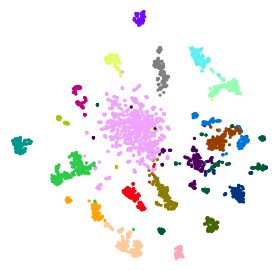

In [66]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    genes = ds.ra.Selected == 1
    print("pca")
    transformed = PCA(n_components=50).fit_transform(data_norm[genes, :].T)
    print("tsne")
    xy = np.array(art_of_tsne(transformed, metric='euclidean')) 
 
    plt.figure(None, (5, 5))
    plt.scatter(xy[:, 0], xy[:, 1], s=10, c=colorize(ds.ca.Punchcard), lw=0, rasterized=True)
    plt.axis('off')
    plt.show()

cells
(3715,)
pca
tsne


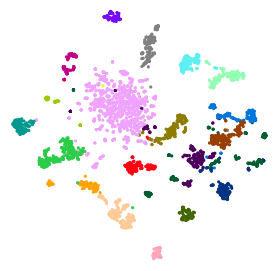

In [411]:
subset = 'harmony_A_T'
n_cells = 5

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    genes = ds.ra.Selected == 1
    punchcard_attr = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    print("cells")
    not_subset_cells = np.where(punchcard_attr != subset)[0]
    subset_cells = np.where(punchcard_attr == subset)[0]
    subset_cells = np.random.choice(subset_cells, n_cells, replace=False)
    cells = np.hstack((subset_cells, not_subset_cells))
    print(cells.shape)
    print("pca")
    transformed = PCA(n_components=50).fit_transform(data_norm[genes, :][:, cells].T)
    print("tsne")
    xy = np.array(art_of_tsne(transformed, metric='euclidean')) 
 
    plt.figure(None, (5, 5))
    plt.scatter(xy[:, 0], xy[:, 1], s=10, c=colorize(punchcard_attr)[cells], lw=0, rasterized=True)
    plt.axis('off')
    plt.show()
    

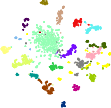

In [412]:
plt.figure(None, (2, 2))

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:

    # color by supercluster
    labels = np.array([cell_dict.get(x) for x in ds.ca.CellID[cells]])
    c = np.array([superclass_color_dict[A_names[x]] for x in labels])

    plt.scatter(xy[:, 0], xy[:, 1], c=c, s=2, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled10_DownsampledMammillary_superclusters.pdf', dpi=300)

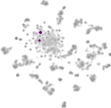

In [413]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    plt.figure(None, (2, 2))
    ix = punchcard_attr[cells] == 'harmony_A_T'
    plt.scatter(xy[:, 0], xy[:, 1], s=5, c='grey', alpha=0.10, lw=0, rasterized=True)
    plt.scatter(xy[ix, 0], xy[ix, 1], s=5, c='purple', lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/Downsampled10_DownsampledMammillary.pdf', dpi=300)

cells
(2910,)
pca
tsne


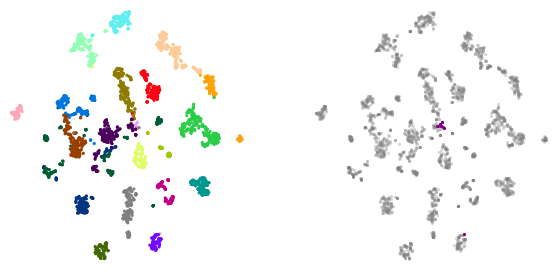

cells
(3670,)
pca
tsne


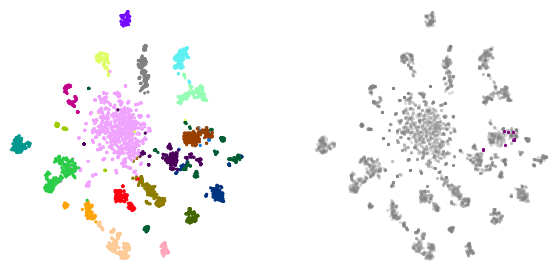

cells
(3670,)
pca
tsne


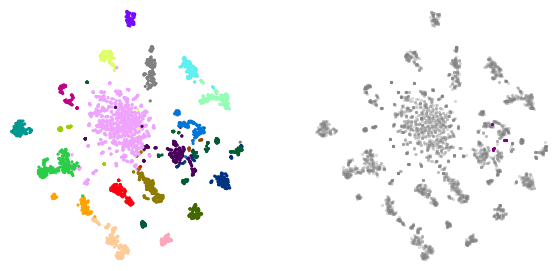

cells
(3630,)
pca
tsne


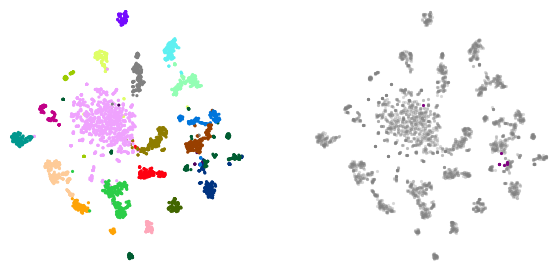

cells
(3610,)
pca
tsne


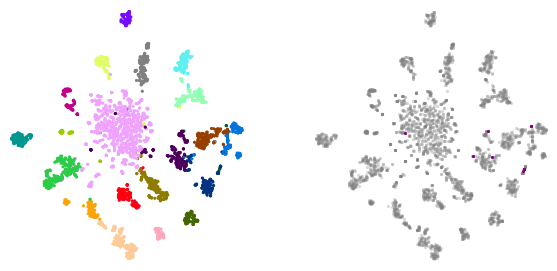

cells
(3570,)
pca
tsne


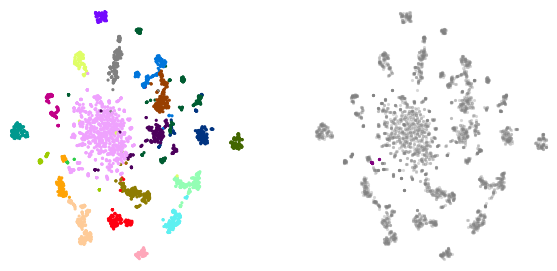

cells
(3620,)
pca
tsne


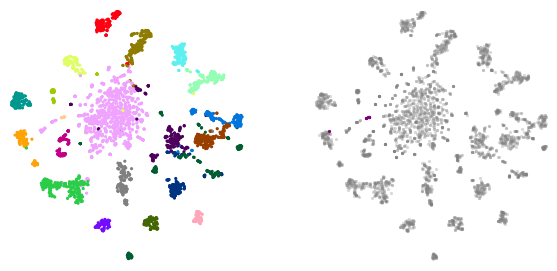

cells
(3660,)
pca
tsne


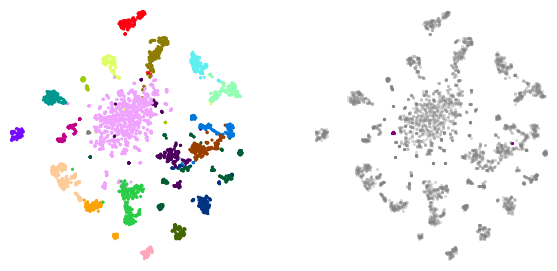

cells
(3660,)
pca
tsne


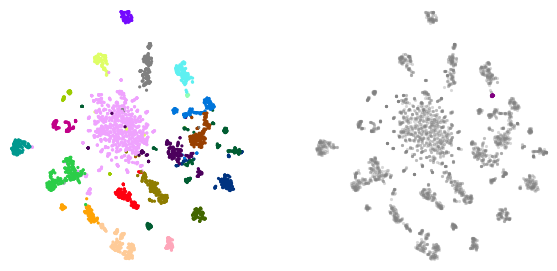

cells
(3650,)
pca
tsne


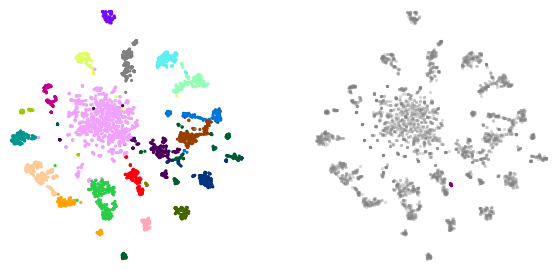

cells
(3770,)
pca
tsne


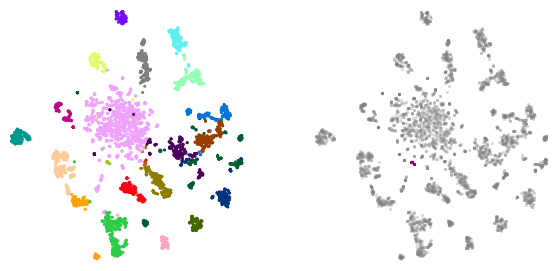

cells
(3730,)
pca
tsne


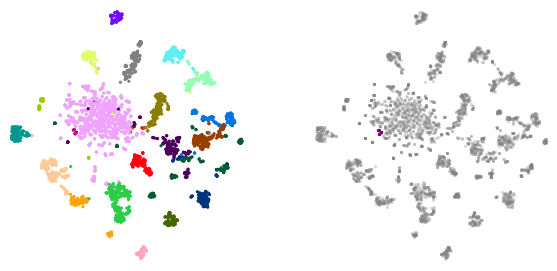

cells
(3680,)
pca
tsne


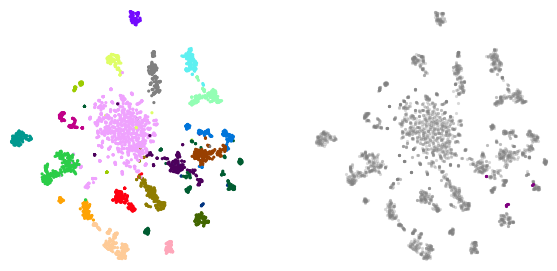

cells
(3710,)
pca
tsne


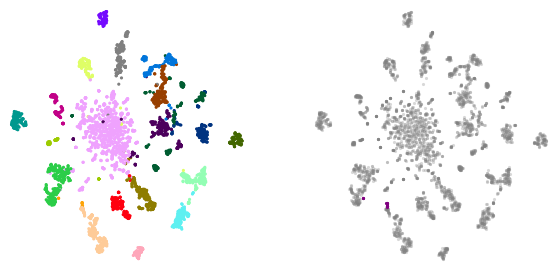

cells
(3760,)
pca
tsne


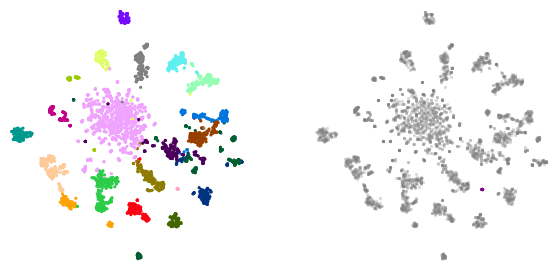

cells
(3740,)
pca
tsne


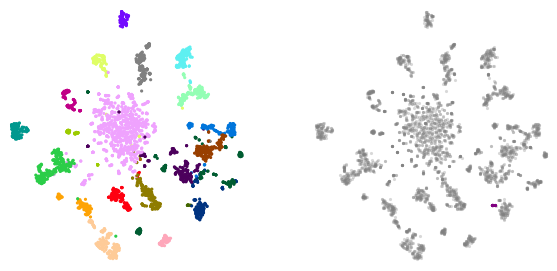

cells
(3690,)
pca
tsne


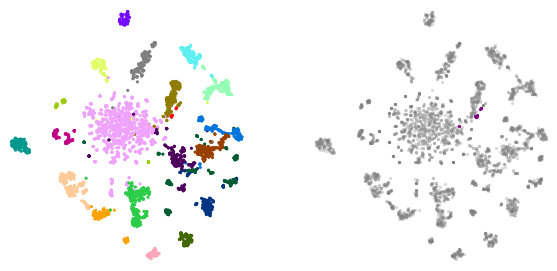

cells
(3700,)
pca
tsne


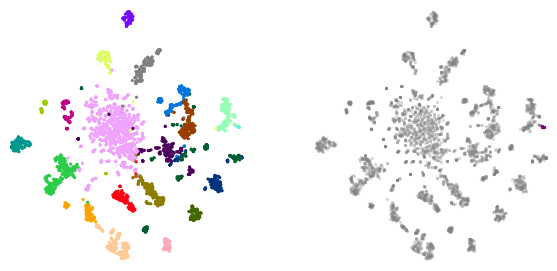

cells
(3710,)
pca
tsne


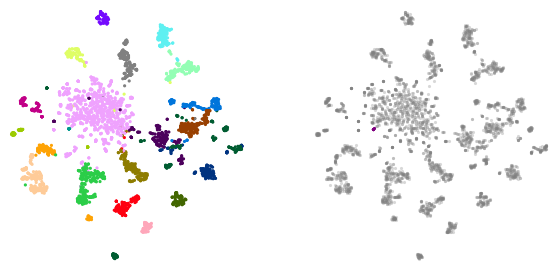

cells
(3720,)
pca
tsne


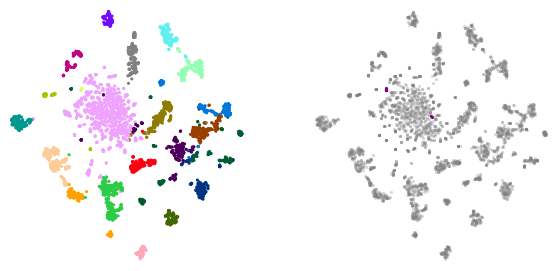

cells
(3750,)
pca
tsne


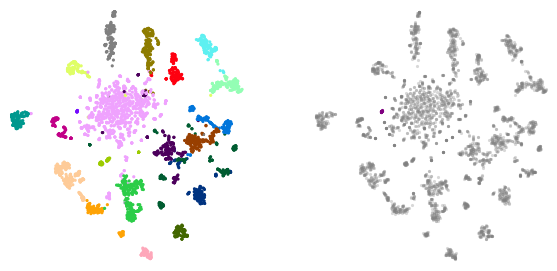

In [289]:
n_cells = 10

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    punchcard_attr = np.array([cell_dict.get(x) for x in ds.ca.CellID])
    
    for subset in np.unique(punchcard_attr):
        
        genes = ds.ra.Selected == 1
        not_subset_cells = np.where(punchcard_attr != subset)[0]
        subset_cells = np.where(punchcard_attr == subset)[0]
        subset_cells = np.random.choice(subset_cells, n_cells, replace=False)
        cells = np.hstack((subset_cells, not_subset_cells))
        print(subset, ':', cells.shape[0], cells)
        
        transformed = PCA(n_components=50).fit_transform(data_norm[genes, :][:, cells].T)
        xy = np.array(art_of_tsne(transformed, metric='euclidean')) 

        plt.figure(None, (10, 5))
        plt.subplot(121)
        plt.scatter(xy[:, 0], xy[:, 1], s=10, c=colorize(punchcard_attr)[cells], lw=0, rasterized=True)
        plt.axis('off')
        plt.subplot(122)
        ix = punchcard_attr[cells] == subset
        plt.scatter(xy[:, 0], xy[:, 1], s=10, c='grey', alpha=0.30, lw=0, rasterized=True)
        plt.scatter(xy[ix, 0], xy[ix, 1], s=10, c='purple', lw=0, rasterized=True)
        plt.axis('off')
        plt.show()
    

In [75]:
from sklearn.neighbors import KNeighborsClassifier

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled10.loom', 'r') as ds:
    
    # assign each supercluster an index in the desired order
    ix_dict = dict(zip(superclusters, range(21)))
    print(ix_dict)
    # get index of every cell
    punchcard_attr = np.array([ix_dict[A_names[cell_dict.get(x)]] for x in ds.ca.CellID])
    
    # empy prediction matrix
    all_pred = np.zeros((21, 21))
    
    # use the cytograph PCA
    transformed = ds.ca.PCA    
    
    for subset in np.unique(punchcard_attr):
                                
        # use a KNN classifier with k=5
        knn = KNeighborsClassifier(n_neighbors=5)
        ix = punchcard_attr != subset
        # fit only cells that are not in the subset
        knn.fit(transformed[ix], punchcard_attr[ix])
        # predict on cells in the subset
        ix = punchcard_attr == subset
        pred = knn.predict(transformed[ix])
        
        # normalize predictions by total cells in the subset
        n_cells = ix.sum()
        all_pred[subset] = np.array([(pred == x).sum() for x in np.unique(punchcard_attr)])  / n_cells
    

{'Upper-layer IT': 0, 'Deep-layer IT': 1, 'Deep-layer NP': 2, 'Deep-layer 6CT/b': 3, 'MGE interneuron': 4, 'CGE interneuron': 5, 'LAMP5-LHX6 and Chandelier': 6, 'Miscellaneous': 7, 'Hippocampus CA1-3': 8, 'Hippocampus CA4': 9, 'Hippocampus DG': 10, 'Amygdala excitatory': 11, 'Medium spiny neuron (MSN)': 12, 'Eccentric MSN': 13, 'Splatter': 14, 'Mammillary body': 15, 'Thalamic excitatory': 16, 'Midbrain-derived inhibitory': 17, 'Upper rhombic lip': 18, 'Cerebellar inhibitory': 19, 'Lower rhombic lip': 20}


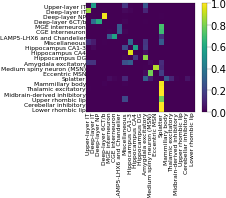

In [76]:
plt.figure(None, (2.5, 2))
ax = plt.subplot(111)
plt.imshow(all_pred)
plt.xticks(range(21), superclusters, rotation=90, fontsize=6)
plt.yticks(range(21), superclusters, fontsize=6)
ax.tick_params(length=0)
plt.colorbar(shrink=1)
plt.savefig(f'{figure_folder}/Downsampled10_knn_minus_one.pdf', dpi=300)

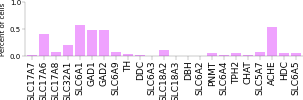

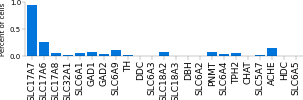

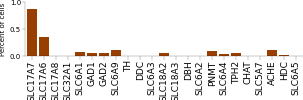

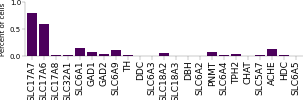

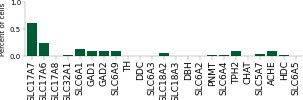

...

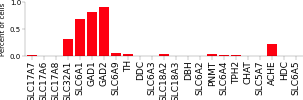

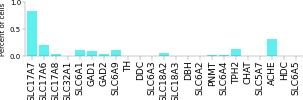

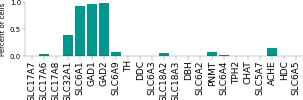

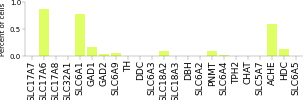

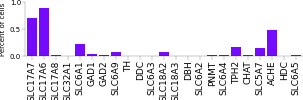

In [158]:
genes = ["SLC17A7", "SLC17A6", "SLC17A8", "SLC32A1", "SLC6A1", "GAD1", "GAD2", "SLC6A9", "TH", "DDC", "SLC6A3", "SLC18A2", "SLC18A3",
    "DBH", "SLC6A2", "PNMT", "SLC6A4", "TPH2", "CHAT", "SLC5A7", "ACHE", "HDC", "SLC6A5"]

with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100.loom', 'r') as ds:
    
    gene_names = ds.ra.Gene
    labels = np.array([ord(cell_dict.get(x)) - 65 for x in ds.ca.CellID])
    colors = colorize(np.unique(labels))
    
    for clust in np.unique(labels):
        
        gene_fracs = []
        
        for g in genes:
        
            supercluster_f_nnz = (ds[gene_names == g, :][:, labels == clust] > 0).sum() / (labels == clust).sum()
            gene_fracs += [supercluster_f_nnz]
            
        plt.figure(None, (5, 1))
        ax = plt.subplot(111)

        plt.bar(genes, gene_fracs, color=colors[clust])

        plt.margins(0.01, 0.01)
        ax.spines.right.set_visible(False)
        ax.spines.top.set_visible(False)
        plt.xticks(rotation=90, fontsize=9)
        plt.yticks(fontsize=7)
        plt.ylabel('Percent of cells', fontsize=7)
        plt.ylim(0, 1)
        plt.show()

In [180]:
def plot_coexp(gene1, gene2):
    
    with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/Downsampled100.loom', 'r') as ds:

        gene_names = ds.ra.Gene
        labels = np.array([ord(cell_dict.get(x)) - 65 for x in ds.ca.CellID])
        colors = colorize(np.unique(labels))

        gene_fracs = []

        for clust in np.unique(labels):

            supercluster_nnz = (ds[gene_names == gene1, :][:, labels == clust] > 0) & (ds[gene_names == gene2, :][:, labels == clust] > 0)
            gene_fracs += [supercluster_nnz.sum() / (labels == clust).sum()]

        plt.figure(None, (5, 1))
        ax = plt.subplot(111)

        plt.bar(np.unique(labels), gene_fracs, color=colors)

        plt.margins(0.01, 0.01)
        ax.spines.right.set_visible(False)
        ax.spines.top.set_visible(False)
        plt.xticks(rotation=90, fontsize=9)
        plt.yticks(fontsize=9)
        plt.ylabel('Percent of cells', fontsize=9)
        plt.title(f"{gene1}; {gene2}")
        plt.show()

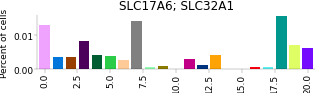

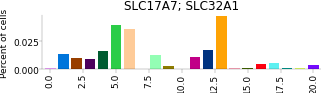

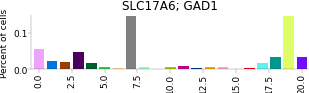

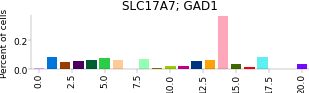

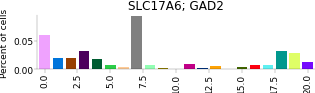

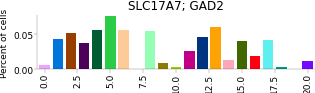

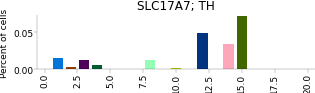

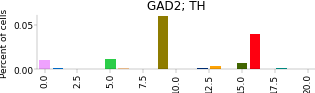

In [182]:
pairs = [
    ("SLC17A6", "SLC32A1"),
    ("SLC17A7", "SLC32A1"),
    ("SLC17A6", "GAD1"),
    ("SLC17A7", "GAD1"),
    ("SLC17A6", "GAD2"),
    ("SLC17A7", "GAD2"),
    ("SLC17A7", "TH"),
    ("GAD2", "TH"),
]

for p in pairs:    
    plot_coexp(p[0], p[1])

# Reanalyze adolescent mouse brain 

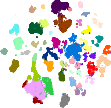

In [41]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL5.loom', 'r') as ds:

    plt.figure(None, (2, 2))
    plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=colorize(ds.ca.Clusters), s=0.5, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/MouseL5.pdf', dpi=300)

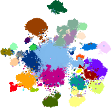

In [61]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:

    plt.figure(None, (2, 2))
    plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], c=colorize(ds.ca.Clusters), s=1, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/MouseL1.pdf', dpi=300)

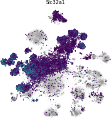

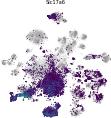

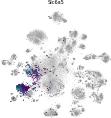

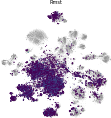

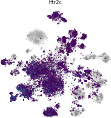

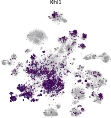

In [59]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:

    splatter_markers = ['Slc32a1', 'Slc17a6', 'Slc6a5', 'Rmst',  'Htr2c', 'Klhl1']
    
    for g in splatter_markers:
    
        plt.figure(None, (2, 2))
        exp = np.log(ds[np.where(ds.ra.Gene == g)[0][0], :].flatten() + 1)
        cells = exp > 0
        plt.scatter(ds.ca.TSNE[:, 0], ds.ca.TSNE[:, 1], color='grey', alpha=0.05, s=1, lw=0, rasterized=True)
        plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=exp[cells], s=1, lw=0, rasterized=True)
        plt.margins(0.01, 0.01)
        plt.axis('off')
        plt.title(g, fontsize=5)
        plt.savefig(f'{figure_folder}/MouseL5_{g}.pdf', dpi=300)

In [28]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:
    print(ds.ca.keys())

['Age', 'AnalysisPool', 'AnalysisProject', 'CellConc', 'CellID', 'ChipID', 'ClassProbability_Astrocyte', 'ClassProbability_Astrocyte,Immune', 'ClassProbability_Astrocyte,Neurons', 'ClassProbability_Astrocyte,Oligos', 'ClassProbability_Astrocyte,Vascular', 'ClassProbability_Bergmann-glia', 'ClassProbability_Blood', 'ClassProbability_Blood,Vascular', 'ClassProbability_Enteric-glia', 'ClassProbability_Enteric-glia,Cycling', 'ClassProbability_Ependymal', 'ClassProbability_Ex-Neurons', 'ClassProbability_Ex-Vascular', 'ClassProbability_Immune', 'ClassProbability_Immune,Neurons', 'ClassProbability_Immune,Oligos', 'ClassProbability_Neurons', 'ClassProbability_Neurons,Cycling', 'ClassProbability_Neurons,Oligos', 'ClassProbability_Neurons,Satellite-glia', 'ClassProbability_Neurons,Vascular', 'ClassProbability_OEC', 'ClassProbability_Oligos', 'ClassProbability_Oligos,Cycling', 'ClassProbability_Oligos,Vascular', 'ClassProbability_Satellite-glia', 'ClassProbability_Satellite-glia,Cycling', 'ClassP

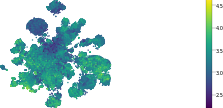

In [80]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:

    plt.figure(None, (4, 2))
    
    ax = plt.subplot(121)
    
    # color by top group
    labels = np.log10(ds.ca.TotalUMI)
    
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=labels[cells], s=2, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    plt.axis('off')
    cbar = plt.colorbar(ax=ax)
    cbar.ax.tick_params(labelsize=5)
    
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.savefig(f'{figure_folder}/MouseL1_TotalUMI.pdf', dpi=300)

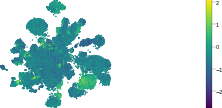

In [81]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:

    plt.figure(None, (4, 2))
    
    ax = plt.subplot(121)
    
    # color by top group
    labels = np.log10(ds.ca.MitoRiboRatio)
    
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=labels[cells], s=2, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    
    ax = plt.subplot(122)
    plt.axis('off')
    cbar = plt.colorbar(ax=ax)
    cbar.ax.tick_params(labelsize=5)
    
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.savefig(f'{figure_folder}/MouseL1_MitoRiboRatio.pdf', dpi=300)

In [86]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:
    print(np.unique(ds.ca.Tissue))

['Amygd' 'CA1' 'CB' 'Ctx1' 'Ctx1.5' 'Ctx2' 'Ctx3' 'DentGyr' 'HC' 'Hypoth'
 'MBd' 'MBv' 'Medulla' 'Pons' 'SC' 'SScortex' 'StriatDor' 'StriatVent'
 'Thal']


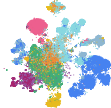

In [87]:
with loompy.connect('/proj/human_adult/20220222/harmony/revision/data/MouseL1.loom', 'r') as ds:

    region_cells = {
        'Cerebral cortex': pd.Series(ds.ca.Tissue).str.contains('x').to_numpy(),
        'Hippocampus': pd.Series(ds.ca.Tissue).isin(['CA1', 'DentGyr', 'HC']).to_numpy(),
        'Cerebral nuclei': pd.Series(ds.ca.Tissue).isin(['Amygd', 'StriatDor', 'StriatVen']).to_numpy(),
        'Hypothalamus': pd.Series(ds.ca.Tissue).isin(['Hypoth']).to_numpy(),
        'Thalamus': pd.Series(ds.ca.Tissue).isin(['Thal']).to_numpy(),
        'Midbrain': pd.Series(ds.ca.Tissue).isin(['MBd', 'MBv']).to_numpy(),
        'Pons': pd.Series(ds.ca.Tissue).isin(['Pons']).to_numpy(),
        'Myelencephalon': pd.Series(ds.ca.Tissue).isin(['Medulla']).to_numpy(),
        'Cerebellum': pd.Series(ds.ca.Tissue).isin(['CB']).to_numpy(),
    }

    plt.figure(None, (2, 2))
    
    c = np.empty(ds.shape[1], dtype='object')
    for reg, cells in region_cells.items():
        c[cells] = color_dict[reg]
        
    cells = np.random.permutation(ds.shape[1])
    plt.scatter(ds.ca.TSNE[cells, 0], ds.ca.TSNE[cells, 1], c=c[cells].astype('str'), s=1, lw=0, rasterized=True)
    plt.margins(0.01, 0.01)
    plt.axis('off')
    plt.savefig(f'{figure_folder}/MouseL1_Regions.pdf', dpi=300)